✅ Directories verified.
✅ Loaded 14 CSV files.
✅ Loaded 14 embedding sets.
📊 Processing: data_12_exponential (Model: llama)
📊 Processing: data_53_quadratic (Model: llama)
📊 Processing: data_75_exponential (Model: llama)
📊 Processing: data_50_exponential (Model: llama)
📊 Processing: data_85_quadratic (Model: llama)
📊 Processing: data_24_exponential (Model: llama)
📊 Processing: data_51_quadratic (Model: llama)
📊 Processing: data_58_quadratic (Model: llama)
📊 Processing: data_49_linear (Model: llama)📊 Processing: data_70_linear (Model: llama)

📊 Processing: data_15_quadratic (Model: llama)
📊 Processing: data_47_cubic (Model: llama)
📊 Processing: data_91_linear (Model: llama)
📊 Processing: data_80_cubic (Model: llama)
✅ Cluster similarity analysis completed.
✅ Results saved to CSV files.


/tmp/ipykernel_973/3571337628.py:176: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Model", y="Distance Correlation", data=results_df, palette="viridis")


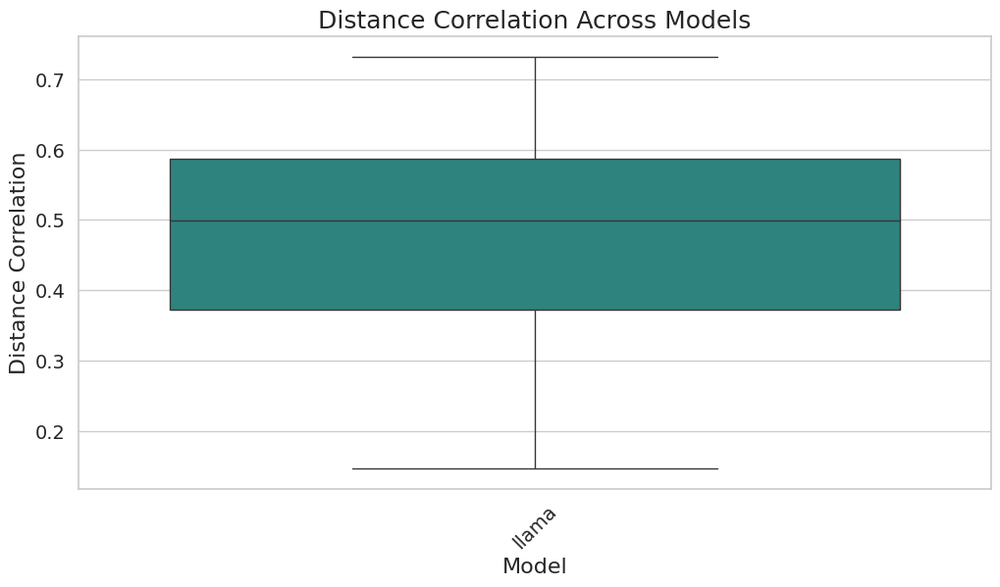

/tmp/ipykernel_973/3571337628.py:186: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Model", y="Cosine Similarity", data=results_df, palette="coolwarm")


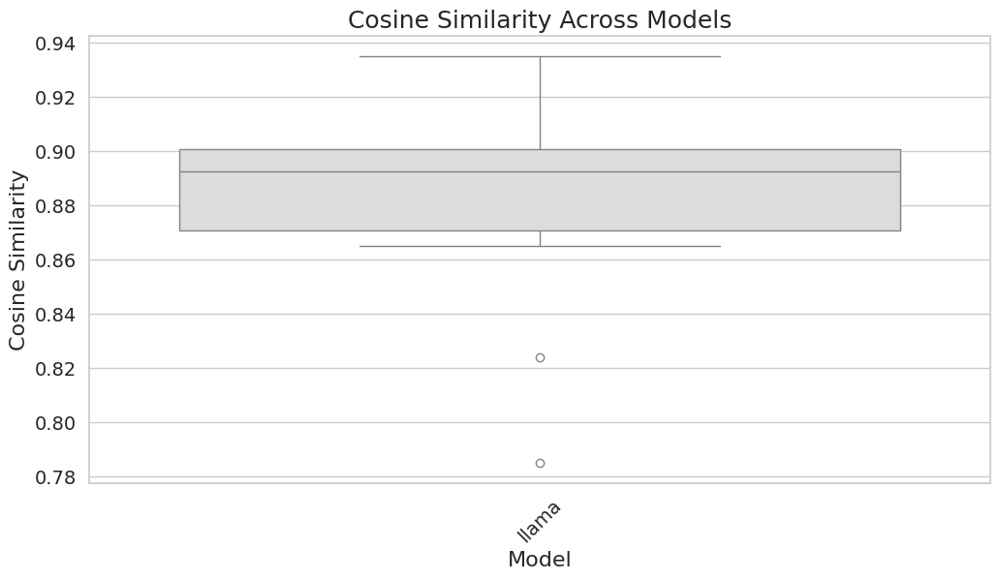

In [30]:
import os
import numpy as np
import pandas as pd
import multiprocessing
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from scipy.spatial.distance import pdist, squareform
from scipy.stats import spearmanr
from sklearn.metrics.pairwise import cosine_similarity
import h5py

# Define directories
#"\\wsl.localhost\Ubuntu\home\abbasali\synthetic data\generated_data"
input_dir = "/home/abbasali/synthetic data/generated_data_llama"  # WSL path
output_dir = "/home/abbasali/synthetic data/embeddings_llama"  # WSL path

# Ensure directories exist
if not os.path.exists(input_dir):
    raise FileNotFoundError(f"❌ Directory not found: {input_dir}")
if not os.path.exists(output_dir):
    raise FileNotFoundError(f"❌ Directory not found: {output_dir}")

print("✅ Directories verified.")

# Load all CSV datasets
dataframes = {}
csv_files = [f for f in os.listdir(input_dir) if f.endswith(".csv")]

for file in csv_files:
    file_path = os.path.join(input_dir, file)
    dataset_name = os.path.splitext(file)[0]  # Extract dataset name (without .csv)
    dataframes[dataset_name] = pd.read_csv(file_path)

print(f"✅ Loaded {len(dataframes)} CSV files.")

# Load all embeddings from HDF5 files
embeddings_data = {}
embedding_files = [f for f in os.listdir(output_dir) if f.endswith(".h5")]

for file in embedding_files:
    file_parts = file.split("_")
    dataset_name = "_".join(file_parts[1:]).replace(".h5", "")
    
    if dataset_name in dataframes:  # Only keep embeddings that match available datasets
        if dataset_name not in embeddings_data:
            embeddings_data[dataset_name] = {}
        
        with h5py.File(os.path.join(output_dir, file), 'r') as h5f:
            embeddings = h5f['embeddings'][:]
            embeddings_data[dataset_name]['llama'] = embeddings  # Assuming 'llama' model

print(f"✅ Loaded {len(embeddings_data)} embedding sets.")

def find_optimal_clusters(data, max_k=10):
    """
    Uses the Elbow Method and Silhouette Score to find the optimal number of clusters.
    
    Parameters:
    - data: numpy array (data to cluster)
    - max_k: int (maximum number of clusters to test)

    Returns:
    - optimal_k: int (optimal number of clusters)
    """
    distortions = []
    silhouette_scores = []
    K_range = range(2, min(max_k, len(data)))  # Ensure K is valid for the data size

    for k in K_range:
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10).fit(data)
        distortions.append(kmeans.inertia_)

        if len(data) > k:  # Avoid errors for small data
            silhouette_avg = silhouette_score(data, kmeans.labels_)
            silhouette_scores.append(silhouette_avg)

    # Find elbow point using second derivative method
    if len(distortions) > 2:
        elbow_point = np.diff(distortions, 2).argmin() + 2
    else:
        elbow_point = 2  # Default to 2 clusters if we lack enough points

    # Choose best number of clusters
    if silhouette_scores:
        best_silhouette = K_range[np.argmax(silhouette_scores)]
        optimal_k = best_silhouette if best_silhouette > elbow_point else elbow_point
    else:
        optimal_k = elbow_point

    return optimal_k

def compute_cluster_similarity(dataset_name):
    """Computes cluster relationships between original data and embeddings using a fixed number of clusters."""
    results = []
    
    # Load original dataset
    df = dataframes[dataset_name]

    # Select continuous numerical features
    continuous_features = df.iloc[:, :3].values

    # Limit sample size
    sample_size = min(300, continuous_features.shape[0])
    continuous_sample = continuous_features[:sample_size]

    # Define a fixed number of clusters
    fixed_num_clusters = 5  # Adjust based on your data characteristics

    # Apply KMeans clustering to the original data
    kmeans_orig = KMeans(n_clusters=fixed_num_clusters, random_state=42, n_init=10).fit(continuous_sample)
    centroids_orig = kmeans_orig.cluster_centers_

    # Compute pairwise distances between original centroids
    dist_orig = squareform(pdist(centroids_orig, metric='euclidean'))

    # Process each model's embeddings
    for model_name, embeddings in embeddings_data[dataset_name].items():
        print(f"📊 Processing: {dataset_name} (Model: {model_name})")

        # Reduce sample size for embeddings
        embeddings_sample = embeddings[:sample_size]

        # Apply KMeans clustering to the embeddings
        kmeans_emb = KMeans(n_clusters=fixed_num_clusters, random_state=42, n_init=10).fit(embeddings_sample)
        centroids_emb = kmeans_emb.cluster_centers_

        # Compute pairwise distances between embedding centroids
        dist_emb = squareform(pdist(centroids_emb, metric='euclidean'))

        # Compute Spearman correlation
        correlation, _ = spearmanr(dist_orig.flatten(), dist_emb.flatten())

        # Compute cosine similarity
        cosine_sim = cosine_similarity(dist_orig.flatten().reshape(1, -1), dist_emb.flatten().reshape(1, -1))[0][0]

        # Store results
        results.append({
            "Dataset": dataset_name,
            "Model": model_name,
            "Fixed Clusters": fixed_num_clusters,
            "Distance Correlation": round(correlation, 3),
            "Cosine Similarity": round(cosine_sim, 3)
        })

    return results

if __name__ == "__main__":
    num_workers = min(multiprocessing.cpu_count(), len(dataframes))  # Limit to CPU count

    with multiprocessing.Pool(num_workers) as pool:
        all_results = pool.map(compute_cluster_similarity, list(dataframes.keys()))

    # Flatten list of lists
    final_results = [item for sublist in all_results for item in sublist]

    # Convert to DataFrame
    results_df = pd.DataFrame(final_results)

    print("✅ Cluster similarity analysis completed.")

    # Summary statistics by model
    summary = results_df.groupby("Model")[["Distance Correlation", "Cosine Similarity"]].agg(["mean", "std"]).reset_index()

    # Save results
    results_df.to_csv("cluster_similarity_results.csv", index=False)
    summary.to_csv("model_summary_results.csv", index=False)

    print("✅ Results saved to CSV files.")

# Set visualization style
sns.set(style="whitegrid")

# Boxplot for Distance Correlation across Models
plt.figure(figsize=(12, 6))
sns.boxplot(x="Model", y="Distance Correlation", data=results_df, palette="viridis")
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Model", fontsize=16)
plt.ylabel("Distance Correlation", fontsize=16)
plt.title("Distance Correlation Across Models", fontsize=18)
plt.show()

# Boxplot for Cosine Similarity across Models
plt.figure(figsize=(12, 6))
sns.boxplot(x="Model", y="Cosine Similarity", data=results_df, palette="coolwarm")
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Model", fontsize=16)
plt.ylabel("Cosine Similarity", fontsize=16)
plt.title("Cosine Similarity Across Models", fontsize=18)
plt.show()


In [20]:
import os
import numpy as np
import pandas as pd
import h5py
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.impute import SimpleImputer
from scipy.spatial.distance import pdist, squareform
from scipy.stats import spearmanr
from sklearn.metrics.pairwise import cosine_similarity

# ✅ Ask user explicitly to re-run clustering or llama processing
def get_yes_no_input(prompt):
    while True:
        user_input = input(prompt).strip().lower()
        if user_input in ["yes", "y"]:
            return True
        elif user_input in ["no", "n"]:
            return False
        print("⚠️ Invalid input! Please enter 'yes' or 'no'.")

RE_RUN = get_yes_no_input("🔄 Do you want to re-run clustering analysis? (yes/no): ")
RE_RUN_LLAMA = get_yes_no_input("🔄 Do you want to re-run Llama processing? (yes/no): ")

# ✅ Define dataset-embedding pairs with correct file extensions
processing_sets = [
    {
        "input_dir": "/home/abbasali/synthetic data/generated_data",
        "output_dir": "/home/abbasali/synthetic data/embeddings",
        "file_ext": ".npy",
        "models": ["bert", "ernie", "gatortron", "roberta", "t5"]
    },
    {
        "input_dir": "/home/abbasali/synthetic data/generated_data_llama",
        "output_dir": "/home/abbasali/synthetic data/embeddings_llama",
        "file_ext": ".h5",
        "models": ["llama"]
    }
]

# ✅ Load previous results if available
RESULTS_FILE = "cluster_similarity_results1.csv"
if os.path.exists(RESULTS_FILE) and not RE_RUN:
    existing_results = pd.read_csv(RESULTS_FILE)
    processed_files = set(zip(existing_results["Dataset"], existing_results["Model"]))
else:
    existing_results = pd.DataFrame()
    processed_files = set()

def load_data(input_dir, output_dir, file_ext, models):
    """Loads CSV datasets and dynamically finds embeddings in the output directory."""
    print(f"📂 Processing {input_dir} -> {output_dir}")

    if not os.path.exists(input_dir) or not os.path.exists(output_dir):
        print(f"❌ ERROR: Missing directory - {input_dir} or {output_dir}")
        return {}, {}

    existing_files = set(os.listdir(output_dir))
    csv_files = [f for f in os.listdir(input_dir) if f.endswith(".csv")]

    if not csv_files:
        print(f"⚠️ No CSV datasets found in {input_dir}")
    
    dataframes = {os.path.splitext(f)[0]: pd.read_csv(os.path.join(input_dir, f)) for f in csv_files}
    print(f"✅ Loaded {len(dataframes)} CSV datasets from {input_dir}.")

    embeddings_data = {}

    for filename in csv_files:
        dataset_name = os.path.splitext(filename)[0]

        for model_name in models:
            # ✅ Dynamically find matching filenames in the directory
            if model_name == "llama":
                matched_files = [f for f in existing_files if f"embeddings_data_{dataset_name}" in f and f.endswith(".h5")]
            else:
                matched_files = [f for f in existing_files if f.startswith(f"embeddings_{model_name}_{dataset_name}") and f.endswith(".npy")]

            if not matched_files:
                print(f"⚠️ WARNING: Missing embeddings for {dataset_name} (Model: {model_name})")
                continue

            embeddings_filepath = os.path.join(output_dir, matched_files[0])

            if (dataset_name, model_name) in processed_files:
                print(f"⚠️ Skipping already processed file: {dataset_name} (Model: {model_name})")
                continue  

            try:
                if model_name == "llama":
                    with h5py.File(embeddings_filepath, 'r') as h5f:
                        embeddings = h5f['embeddings'][:]
                else:
                    embeddings = np.load(embeddings_filepath)

                if embeddings.size == 0:
                    print(f"❌ ERROR: Empty embeddings file detected: {embeddings_filepath}")
                    continue

                # ✅ Ensure embeddings are 2D
                if embeddings.ndim > 2:
                    embeddings = embeddings.reshape(embeddings.shape[0], -1)

                if dataset_name not in embeddings_data:
                    embeddings_data[dataset_name] = {}

                embeddings_data[dataset_name][model_name] = embeddings
                print(f"✅ Loaded embeddings for {dataset_name} (Model: {model_name})")

            except Exception as e:
                print(f"❌ ERROR: Could not load {embeddings_filepath} - {e}")

    return dataframes, embeddings_data

def compute_cluster_similarity(dataframes, embeddings_data):
    """Computes cluster relationships using PCA, t-SNE, and KMeans clustering."""
    results = []
    
    for dataset_name, df in dataframes.items():
        if df.empty:
            print(f"⚠️ Skipping empty dataset: {dataset_name}")
            continue

        continuous_features = df.iloc[:, :3].values
        sample_size = min(300, continuous_features.shape[0])
        continuous_sample = SimpleImputer(strategy="mean").fit_transform(continuous_features[:sample_size])

        optimal_clusters = min(40, len(np.unique(continuous_sample, axis=0)))
        optimal_clusters = max(2, optimal_clusters)

        kmeans_orig = KMeans(n_clusters=optimal_clusters, random_state=42, n_init=10).fit(continuous_sample)
        dist_orig = squareform(pdist(kmeans_orig.cluster_centers_, metric='euclidean'))

        for model_name, embeddings in embeddings_data.get(dataset_name, {}).items():
            print(f"📊 Processing: {dataset_name} (Model: {model_name})")

            embeddings_sample = SimpleImputer(strategy="mean").fit_transform(embeddings[:sample_size])
            pca_embeddings = PCA(n_components=50).fit_transform(embeddings_sample)
            tsne_embeddings = TSNE(n_components=2, perplexity=30, random_state=42).fit_transform(pca_embeddings)

            adjusted_clusters = min(optimal_clusters, len(tsne_embeddings), 10)
            adjusted_clusters = max(2, adjusted_clusters)

            kmeans_emb = KMeans(n_clusters=adjusted_clusters, random_state=42, n_init=10).fit(tsne_embeddings)
            dist_emb = squareform(pdist(kmeans_emb.cluster_centers_, metric='euclidean'))

            min_size = min(dist_orig.size, dist_emb.size)
            dist_orig_resized = dist_orig.flatten()[:min_size]
            dist_emb_resized = dist_emb.flatten()[:min_size]

            correlation, _ = spearmanr(dist_orig_resized, dist_emb_resized)
            cosine_sim = cosine_similarity(dist_orig_resized.reshape(1, -1), dist_emb_resized.reshape(1, -1))[0][0]

            results.append({
                "Dataset": dataset_name,
                "Function Type": dataset_name.split("_")[-1],
                "Model": model_name,
                "Optimal Clusters": optimal_clusters,
                "Adjusted Clusters (Embeddings)": adjusted_clusters,
                "Distance Correlation": round(correlation, 3),
                "Cosine Similarity": round(cosine_sim, 3)
            })
    
    return results

# ✅ Run pipeline
all_results = []
for set_info in processing_sets:
    dataframes, embeddings_data = load_data(set_info["input_dir"], set_info["output_dir"], set_info["file_ext"], set_info["models"])
    all_results.extend(compute_cluster_similarity(dataframes, embeddings_data))

pd.DataFrame(all_results).to_csv("cluster_similarity_results1.csv", index=False)
print("✅ Results saved to cluster_similarity_results1.csv")


🔄 Do you want to re-run clustering analysis? (yes/no):  yes
🔄 Do you want to re-run Llama processing? (yes/no):  yes


📂 Processing /home/abbasali/synthetic data/generated_data -> /home/abbasali/synthetic data/embeddings
✅ Loaded 100 CSV datasets from /home/abbasali/synthetic data/generated_data.
✅ Loaded embeddings for data_79_quadratic (Model: bert)
✅ Loaded embeddings for data_79_quadratic (Model: ernie)
✅ Loaded embeddings for data_79_quadratic (Model: gatortron)
✅ Loaded embeddings for data_79_quadratic (Model: roberta)
✅ Loaded embeddings for data_79_quadratic (Model: t5)
✅ Loaded embeddings for data_91_linear (Model: bert)
✅ Loaded embeddings for data_91_linear (Model: ernie)
✅ Loaded embeddings for data_91_linear (Model: gatortron)
✅ Loaded embeddings for data_91_linear (Model: roberta)
✅ Loaded embeddings for data_91_linear (Model: t5)
✅ Loaded embeddings for data_44_exponential (Model: bert)
✅ Loaded embeddings for data_44_exponential (Model: ernie)
✅ Loaded embeddings for data_44_exponential (Model: gatortron)
✅ Loaded embeddings for data_44_exponential (Model: roberta)
✅ Loaded embeddings f

In [37]:
import os
import numpy as np
import pandas as pd
import h5py
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.impute import SimpleImputer
from scipy.spatial.distance import pdist, squareform
from scipy.stats import spearmanr
from sklearn.metrics.pairwise import cosine_similarity

# ✅ PREDEFINED SETTINGS (Set to False if you don't want to re-run)
RE_RUN = True   # Change to False to skip clustering analysis
RE_RUN_LLAMA = True   # Change to False to skip Llama processing

# ✅ Define dataset-embedding pairs with correct file extensions
processing_sets = [
    {
        "input_dir": "/home/abbasali/synthetic data/generated_data",
        "output_dir": "/home/abbasali/synthetic data/embeddings",
        "file_ext": ".npy",
        "models": ["bert", "ernie", "gatortron", "roberta", "t5", "e5_small", "minilm"]
    },
    {
        "input_dir": "/home/abbasali/synthetic data/generated_data_llama",
        "output_dir": "/home/abbasali/synthetic data/embeddings_llama",
        "file_ext": ".h5",
        "models": ["llama"]
    }
]

# ✅ Load previous results if available
RESULTS_FILE = "cluster_similarity_results.csv"
if os.path.exists(RESULTS_FILE) and not RE_RUN:
    existing_results = pd.read_csv(RESULTS_FILE)
    processed_files = set(zip(existing_results["Dataset"], existing_results["Model"]))
else:
    existing_results = pd.DataFrame()
    processed_files = set()

def load_data(input_dir, output_dir, file_ext, models):
    """Loads CSV datasets and dynamically finds embeddings in the output directory."""
    print(f"\n📂 Processing {input_dir} -> {output_dir}")

    if not os.path.exists(input_dir):
        print(f"❌ ERROR: Input directory not found: {input_dir}")
        return {}, {}

    if not os.path.exists(output_dir):
        print(f"❌ ERROR: Embeddings directory not found: {output_dir}")
        return {}, {}

    # ✅ Explicitly list all files in the embeddings directory
    existing_files = set(os.listdir(output_dir))
    if not existing_files:
        print(f"⚠️ No embeddings found in {output_dir}")

    csv_files = [f for f in os.listdir(input_dir) if f.endswith(".csv")]
    if not csv_files:
        print(f"⚠️ No CSV datasets found in {input_dir} ❌")
    
    dataframes = {os.path.splitext(f)[0]: pd.read_csv(os.path.join(input_dir, f)) for f in csv_files}
    print(f"✅ Loaded {len(dataframes)} CSV datasets from {input_dir}.")

    embeddings_data = {}

    for filename in csv_files:
        dataset_name = os.path.splitext(filename)[0]

        for model_name in models:
            # ✅ Fix: Match naming conventions for different models
            if model_name == "llama":
                matched_files = [f for f in existing_files if dataset_name in f and f.endswith(".h5")]
            elif model_name == "e5_small":
                matched_files = [f for f in existing_files if f.startswith(f"embeddings_e5_small_{dataset_name}") and f.endswith(".npy")]
            elif model_name == "minilm":
                matched_files = [f for f in existing_files if f.startswith(f"embeddings_minilm_{dataset_name}") and f.endswith(".npy")]
            else:
                matched_files = [f for f in existing_files if f.startswith(f"embeddings_{model_name}_{dataset_name}") and f.endswith(".npy")]

            if not matched_files:
                print(f"⚠️ WARNING: Missing embeddings for {dataset_name} (Model: {model_name})")
                continue

            embeddings_filepath = os.path.join(output_dir, matched_files[0])  # Use first match

            if (dataset_name, model_name) in processed_files:
                print(f"⚠️ Skipping already processed file: {dataset_name} (Model: {model_name})")
                continue  

            try:
                if model_name == "llama":
                    with h5py.File(embeddings_filepath, 'r') as h5f:
                        embeddings = h5f['embeddings'][:]
                else:
                    embeddings = np.load(embeddings_filepath)

                if embeddings.size == 0:
                    print(f"❌ ERROR: Empty embeddings file detected: {embeddings_filepath}")
                    continue

                if dataset_name not in embeddings_data:
                    embeddings_data[dataset_name] = {}

                embeddings_data[dataset_name][model_name] = embeddings
                print(f"✅ Loaded embeddings for {dataset_name} (Model: {model_name})")

            except Exception as e:
                print(f"❌ ERROR: Could not load {embeddings_filepath} - {e}")

    if not embeddings_data:
        print(f"⚠️ No embeddings found in {output_dir}")
    
    return dataframes, embeddings_data

def compute_cluster_similarity(dataframes, embeddings_data):
    """Computes cluster relationships using PCA, t-SNE, and KMeans clustering."""
    results = []
    
    for dataset_name, df in dataframes.items():
        if df.empty:
            print(f"⚠️ Skipping empty dataset: {dataset_name}")
            continue

        print(f"\n🔍 Computing cluster similarity for: {dataset_name}")

        continuous_features = df.iloc[:, :3].values
        sample_size = min(300, continuous_features.shape[0])
        continuous_sample = SimpleImputer(strategy="mean").fit_transform(continuous_features[:sample_size])

        optimal_clusters = min(40, len(np.unique(continuous_sample, axis=0)))
        optimal_clusters = max(2, optimal_clusters)

        kmeans_orig = KMeans(n_clusters=optimal_clusters, random_state=42, n_init=10).fit(continuous_sample)
        dist_orig = squareform(pdist(kmeans_orig.cluster_centers_, metric='euclidean'))

        for model_name, embeddings in embeddings_data.get(dataset_name, {}).items():
            print(f"📊 Processing embeddings for {dataset_name} (Model: {model_name})")

            # ✅ Fix: Ensure embeddings are 2D
            if embeddings.ndim > 2:
                print(f"⚠️ Warning: Found 3D embeddings for {dataset_name} (Model: {model_name}), flattening...")
                embeddings = embeddings.reshape(embeddings.shape[0], -1)

            embeddings_sample = SimpleImputer(strategy="mean").fit_transform(embeddings[:sample_size])
            pca_embeddings = PCA(n_components=50).fit_transform(embeddings_sample)
            tsne_embeddings = TSNE(n_components=2, perplexity=30, random_state=42).fit_transform(pca_embeddings)

            adjusted_clusters = min(optimal_clusters, len(tsne_embeddings), 10)
            adjusted_clusters = max(2, adjusted_clusters)

            kmeans_emb = KMeans(n_clusters=adjusted_clusters, random_state=42, n_init=10).fit(tsne_embeddings)
            dist_emb = squareform(pdist(kmeans_emb.cluster_centers_, metric='euclidean'))

            min_size = min(dist_orig.size, dist_emb.size)
            dist_orig_resized = dist_orig.flatten()[:min_size]
            dist_emb_resized = dist_emb.flatten()[:min_size]

            correlation, _ = spearmanr(dist_orig_resized, dist_emb_resized)
            cosine_sim = cosine_similarity(dist_orig_resized.reshape(1, -1), dist_emb_resized.reshape(1, -1))[0][0]

            results.append({
                "Dataset": dataset_name,
                "Function Type": dataset_name.split("_")[-1],
                "Model": model_name,
                "Optimal Clusters": optimal_clusters,
                "Adjusted Clusters (Embeddings)": adjusted_clusters,
                "Distance Correlation": round(correlation, 3),
                "Cosine Similarity": round(cosine_sim, 3)
            })
    
    return results

# ✅ RUN PIPELINE
all_results = []
for set_info in processing_sets:
    dataframes, embeddings_data = load_data(set_info["input_dir"], set_info["output_dir"], set_info["file_ext"], set_info["models"])
    if embeddings_data:
        results = compute_cluster_similarity(dataframes, embeddings_data)
        all_results.extend(results)

# ✅ Save to CSV
results_df = pd.DataFrame(all_results)
if not results_df.empty:
    results_df.to_csv("cluster_similarity_results.csv", index=False)
    print(f"✅ Results saved.")



📂 Processing /home/abbasali/synthetic data/generated_data -> /home/abbasali/synthetic data/embeddings
✅ Loaded 100 CSV datasets from /home/abbasali/synthetic data/generated_data.
✅ Loaded embeddings for data_79_quadratic (Model: bert)
✅ Loaded embeddings for data_79_quadratic (Model: ernie)
✅ Loaded embeddings for data_79_quadratic (Model: gatortron)
✅ Loaded embeddings for data_79_quadratic (Model: roberta)
✅ Loaded embeddings for data_79_quadratic (Model: t5)
✅ Loaded embeddings for data_79_quadratic (Model: e5_small)
✅ Loaded embeddings for data_79_quadratic (Model: minilm)
✅ Loaded embeddings for data_91_linear (Model: bert)
✅ Loaded embeddings for data_91_linear (Model: ernie)
✅ Loaded embeddings for data_91_linear (Model: gatortron)
✅ Loaded embeddings for data_91_linear (Model: roberta)
✅ Loaded embeddings for data_91_linear (Model: t5)
✅ Loaded embeddings for data_91_linear (Model: e5_small)
✅ Loaded embeddings for data_91_linear (Model: minilm)
✅ Loaded embeddings for data_44

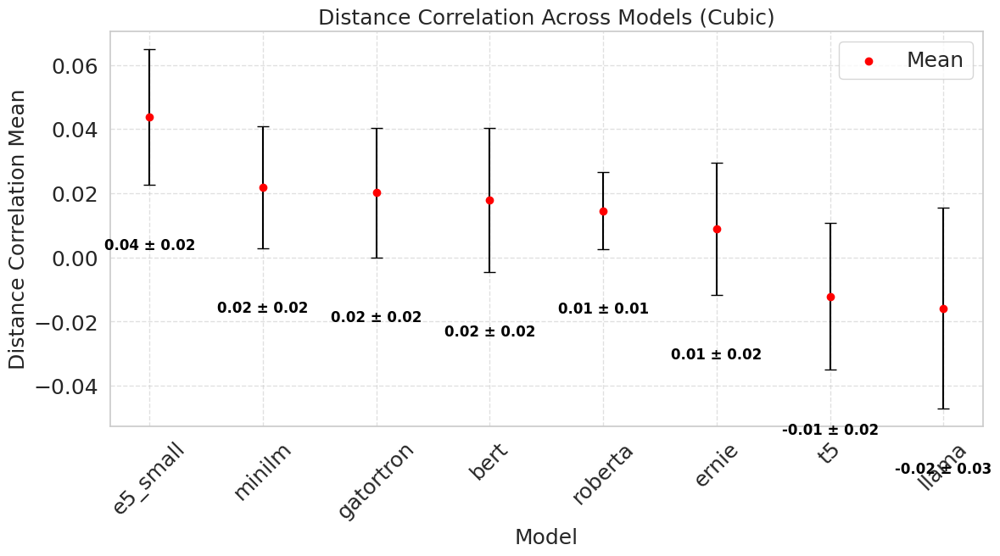

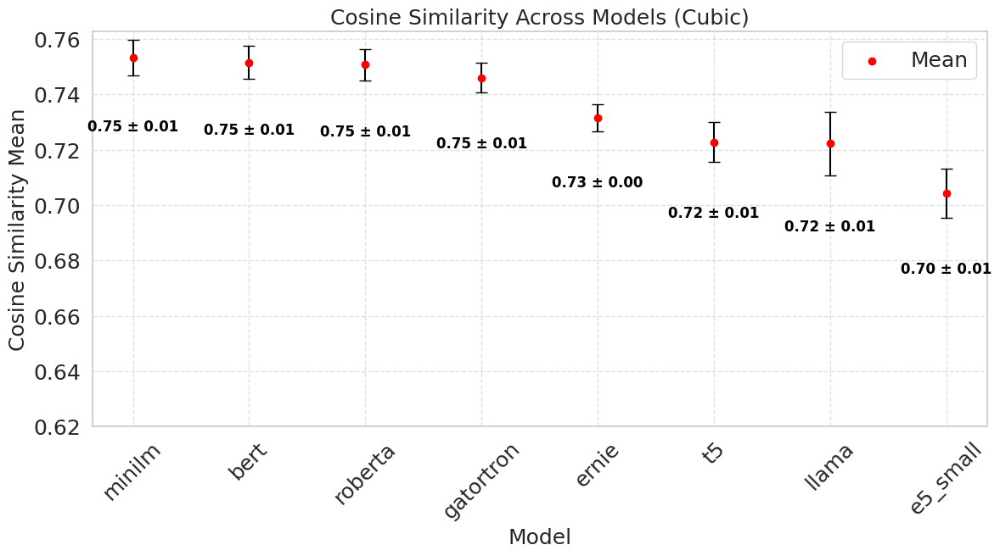

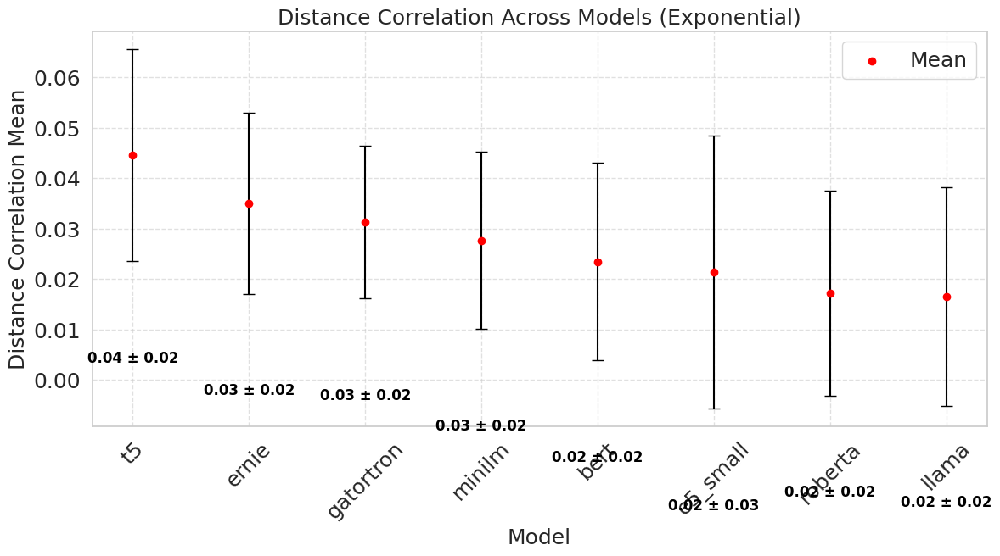

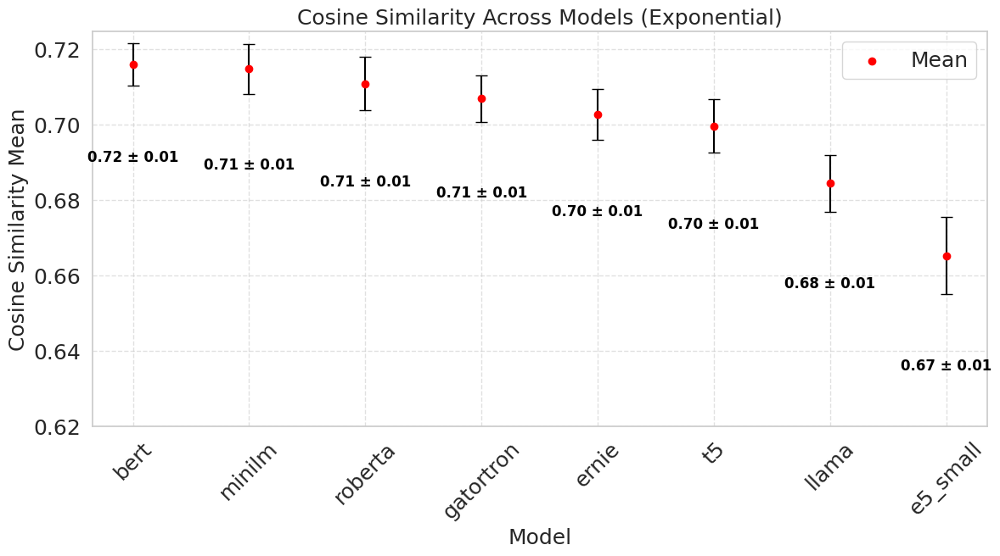

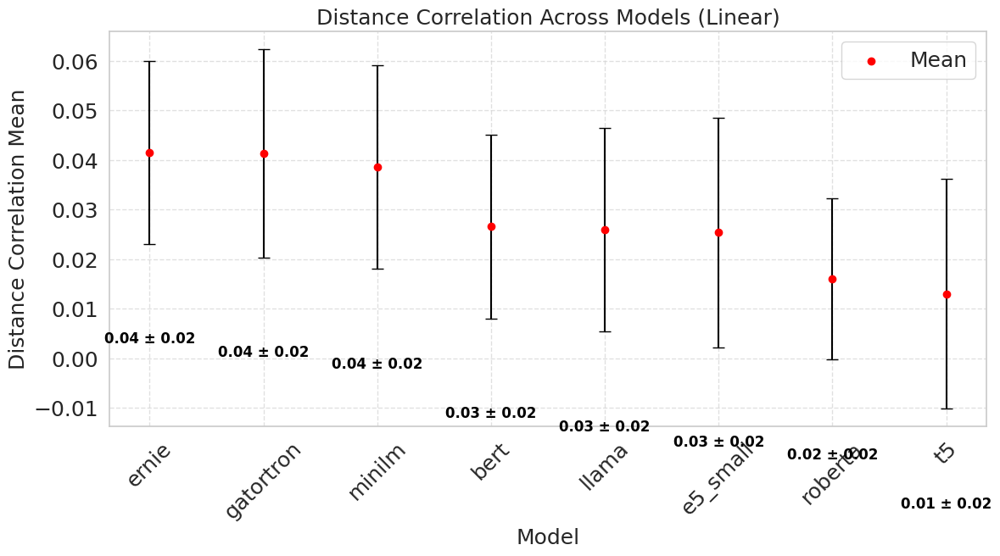

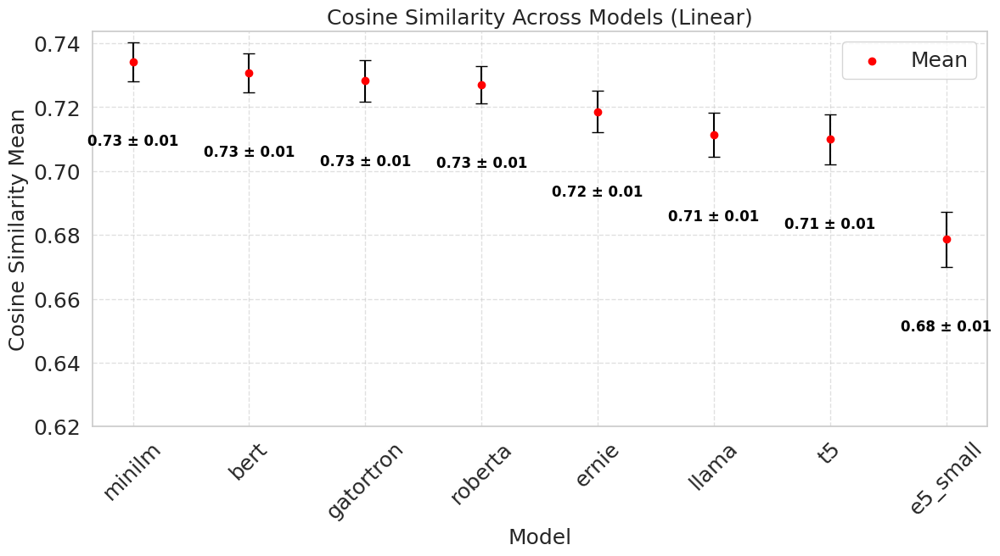

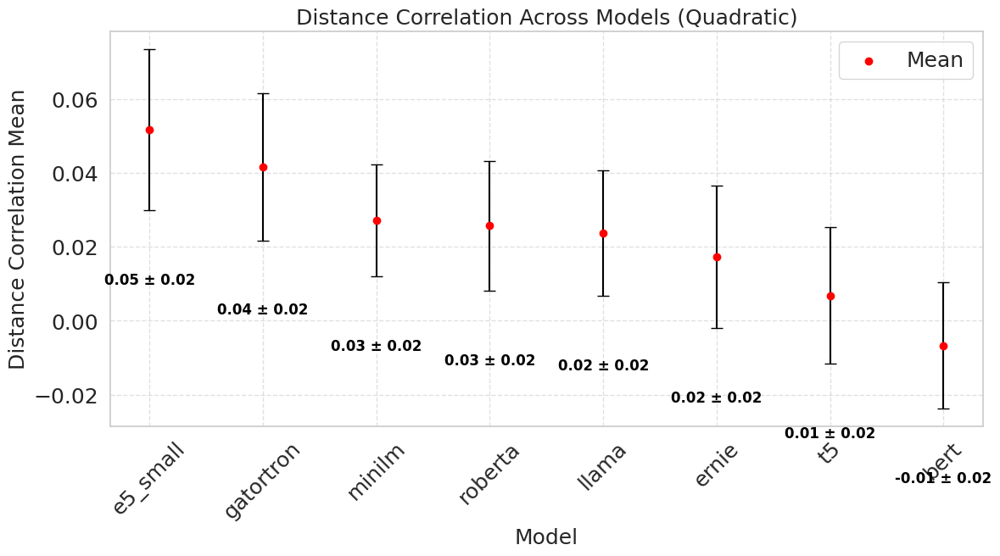

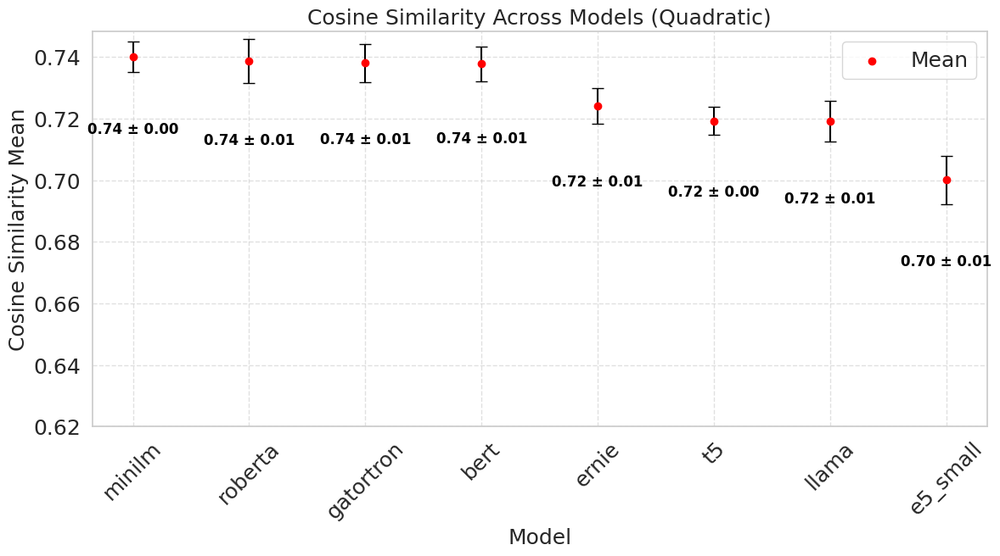

In [38]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import sem

# ✅ Load the results CSV file
RESULTS_FILE = "cluster_similarity_results.csv"
df = pd.read_csv(RESULTS_FILE)

# ✅ Ensure necessary columns exist
required_columns = {"Model", "Function Type", "Distance Correlation", "Cosine Similarity"}
if not required_columns.issubset(df.columns):
    raise ValueError(f"❌ ERROR: Missing required columns in {RESULTS_FILE}!")

# ✅ Compute mean and SEM for Distance Correlation and Cosine Similarity, grouped by Function Type and Model
stats_df = df.groupby(["Function Type", "Model"])[["Distance Correlation", "Cosine Similarity"]].agg(["mean", sem]).reset_index()

# ✅ Rename columns for easier access
stats_df.columns = ["Function Type", "Model", "Distance Mean", "Distance SEM", "Cosine Mean", "Cosine SEM"]

# ✅ Set visualization style
sns.set(style="whitegrid")

# ✅ Create plots for each function type
function_types = stats_df["Function Type"].unique()

for func_type in function_types:
    for metric, metric_name, y_min in zip(
        ["Distance Mean", "Cosine Mean"], 
        ["Distance Correlation", "Cosine Similarity"], 
        [None, 0.62]  # Distance y-axis auto, Cosine starts at 0.5
    ):
        subset = stats_df[stats_df["Function Type"] == func_type]

        # ✅ Sort by mean in descending order
        subset = subset.sort_values(by=metric, ascending=False)

        # Select the corresponding SEM
        sem_column = "Distance SEM" if metric == "Distance Mean" else "Cosine SEM"

        # ✅ Dynamically adjust figure size based on number of models
        fig_height = max(6, len(subset) * 0.8)  # Ensures full graph without scrolling
        plt.figure(figsize=(12, fig_height))

        # Scatter plot for mean values
        plt.scatter(subset["Model"], subset[metric], color="red", label="Mean", zorder=3)

        # Error bars for SEM
        plt.errorbar(subset["Model"], subset[metric], yerr=subset[sem_column], fmt="none", capsize=5, color="black", zorder=2)

        # ✅ Add text annotations for Mean ± SEM **below the x-axis labels**
        for i, row in subset.iterrows():
            plt.text(
                row["Model"], 
                row[metric] - row[sem_column] - 0.02,  # Offset text slightly below error bar
                f"{row[metric]:.2f} ± {row[sem_column]:.2f}", 
                ha="center", 
                fontsize=12, 
                fontweight="bold",
                color="black"
            )

        # ✅ Set labels and title with font size 18
        plt.xlabel("Model", fontsize=18)
        plt.ylabel(f"{metric_name} Mean", fontsize=18)
        plt.title(f"{metric_name} Across Models ({func_type.capitalize()})", fontsize=18)

        # ✅ Set y-axis limits (Cosine starts at 0.5, Distance auto)
        if y_min is not None:
            plt.ylim(y_min, None)

        # ✅ Set font sizes for ticks
        plt.xticks(fontsize=18, rotation=45)
        plt.yticks(fontsize=18)

        # ✅ Add legend
        plt.legend(fontsize=18, loc="upper right")

        plt.grid(True, linestyle="--", alpha=0.6)
        plt.tight_layout()

        # ✅ Insert blank space between plots
        plt.subplots_adjust(bottom=0.2)

        plt.show()


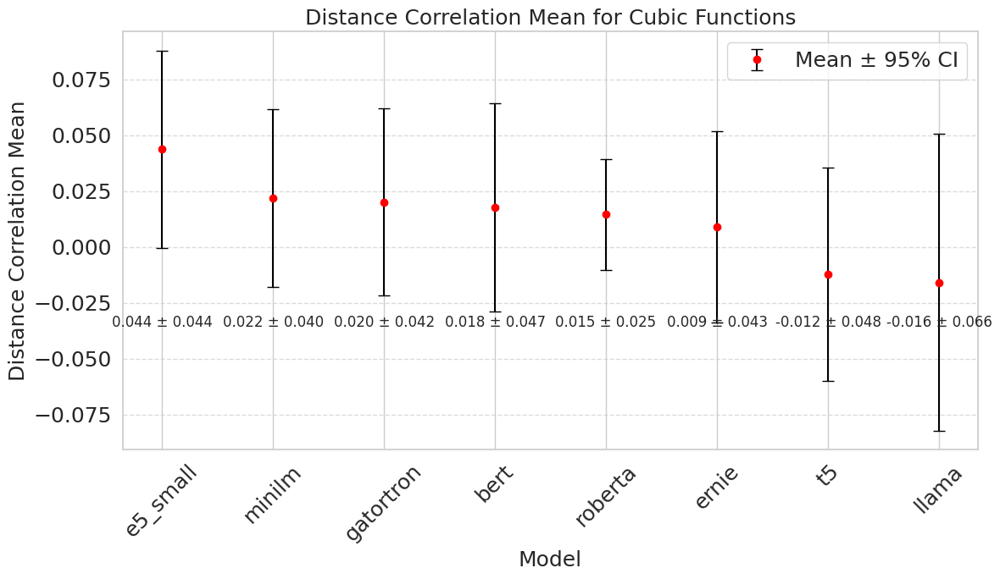

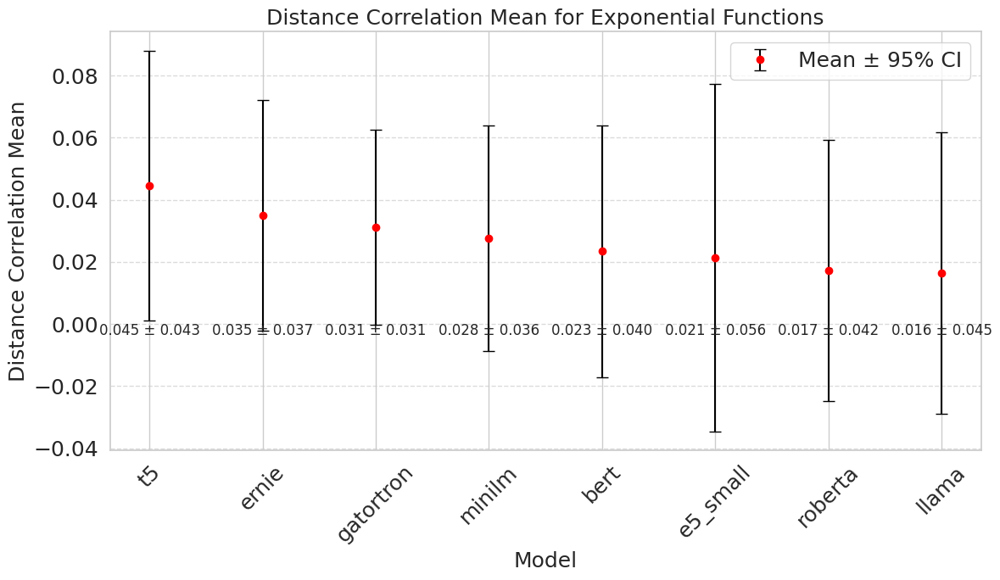

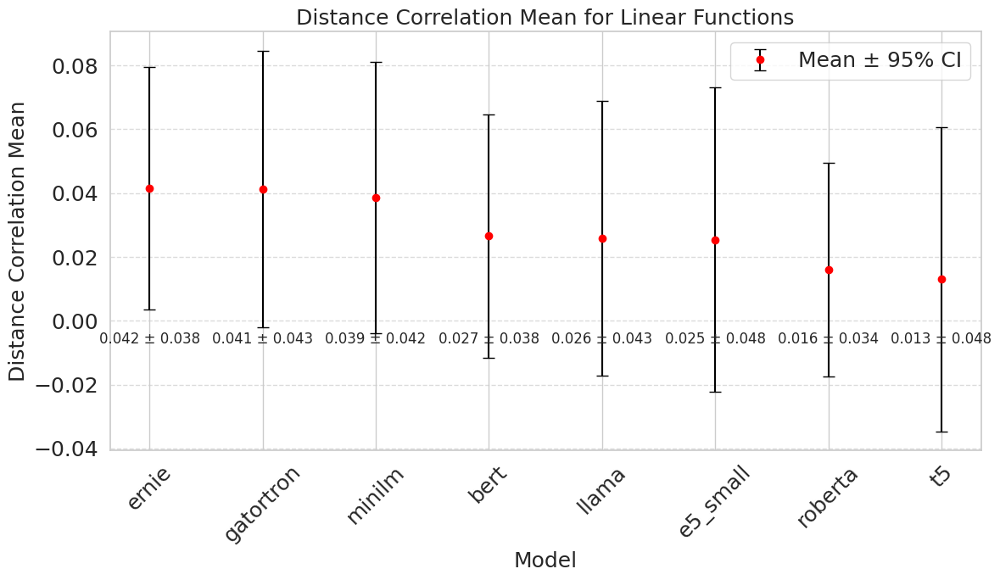

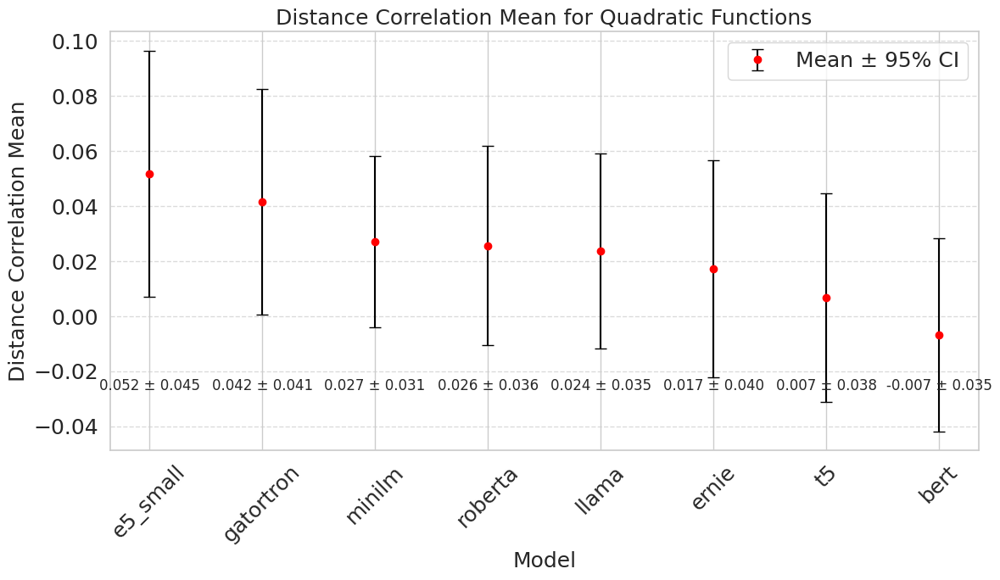

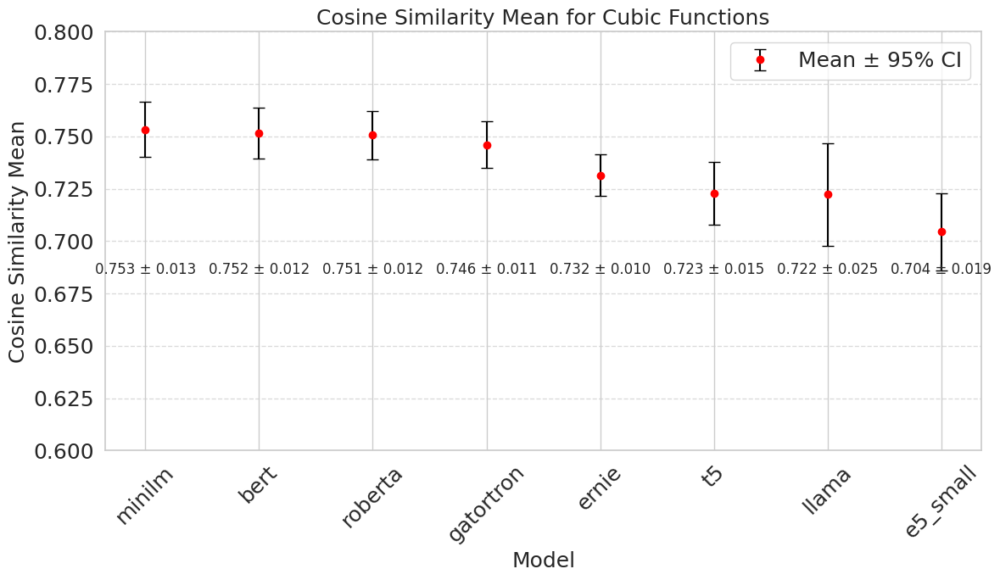

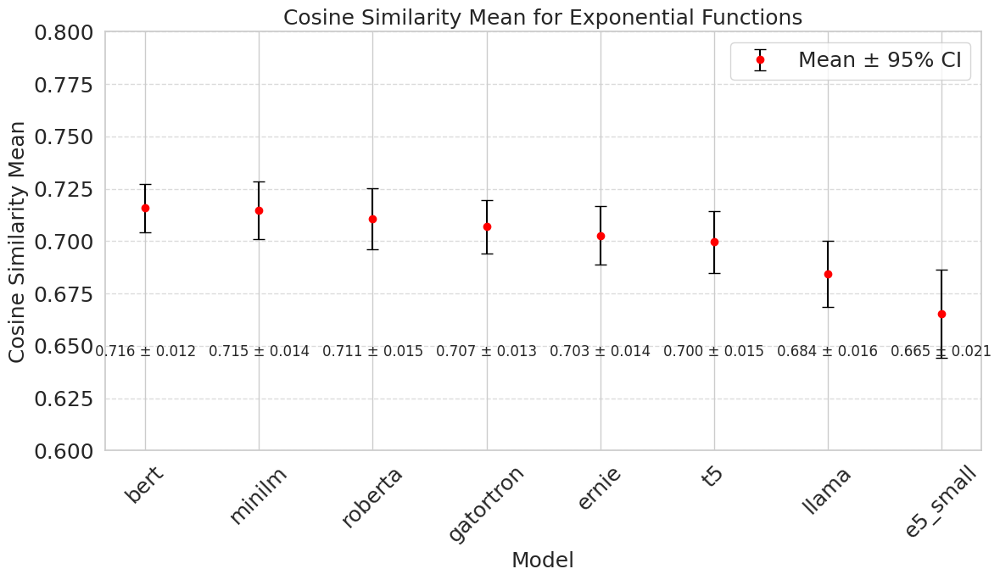

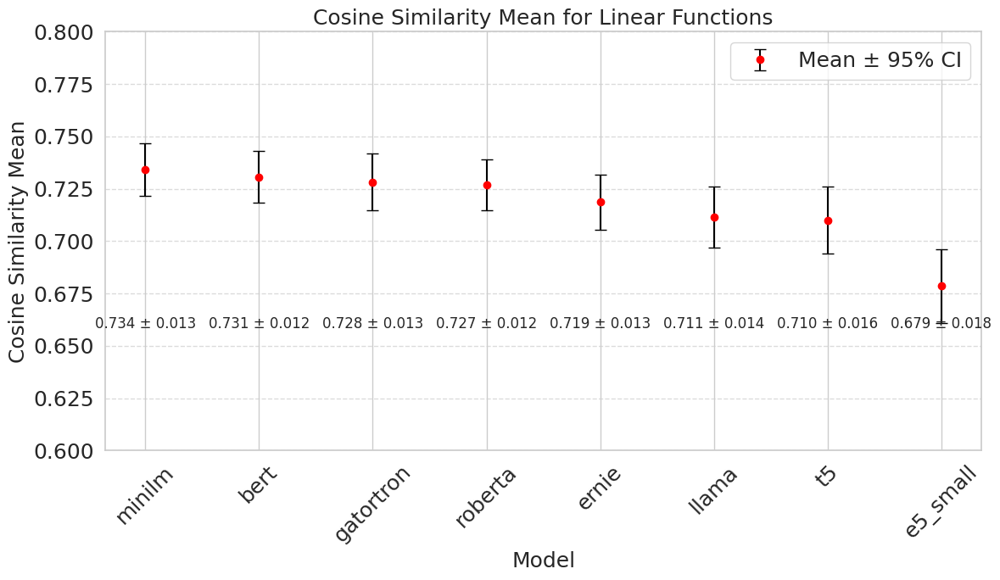

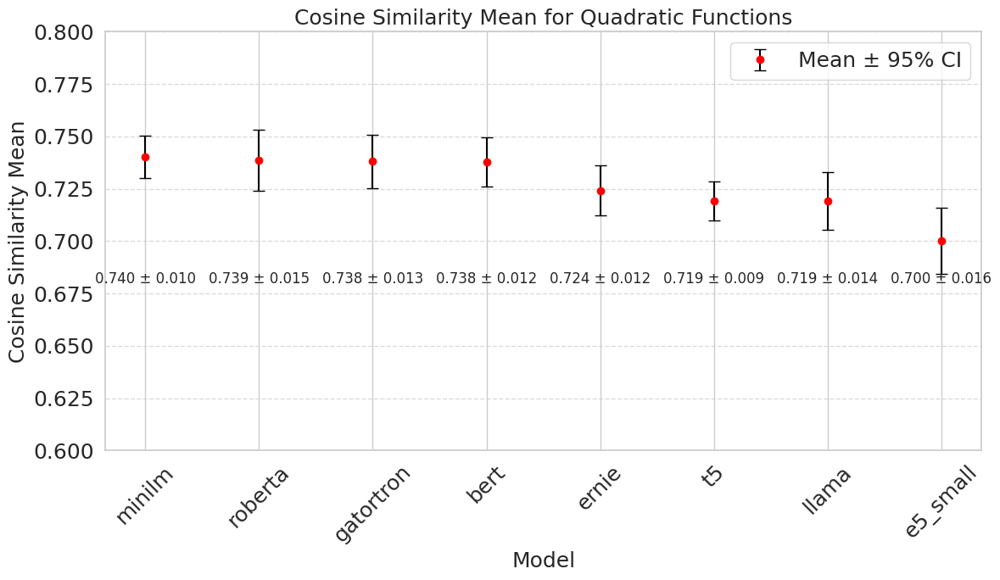

In [39]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats

# ✅ Load the results file
RESULTS_FILE = "cluster_similarity_results.csv"
results_df = pd.read_csv(RESULTS_FILE)

# ✅ Ensure that the dataset column is properly formatted
if "Dataset" in results_df.columns:
    results_df["Function Type"] = results_df["Dataset"].str.extract(r'_(linear|exponential|quadratic|cubic)')
else:
    raise ValueError("❌ ERROR: 'Dataset' column missing from results_df!")

# ✅ Function to calculate mean, SEM, and 95% confidence intervals
def compute_summary(df, metric):
    """Compute mean, standard error, and 95% confidence interval for a given metric."""
    summary_df = df.groupby(["Model", "Function Type"])[metric].agg(["mean", "std", "count"]).reset_index()
    summary_df["sem"] = summary_df["std"] / np.sqrt(summary_df["count"])
    
    # ✅ Compute 95% Confidence Interval using t-distribution
    summary_df["ci95"] = summary_df["sem"] * stats.t.ppf(0.975, df=summary_df["count"]-1)
    
    return summary_df

# ✅ Compute statistics for Distance Correlation and Cosine Similarity
distance_summary = compute_summary(results_df, "Distance Correlation")
cosine_summary = compute_summary(results_df, "Cosine Similarity")

# ✅ Function to plot Mean ± 95% CI Error Bars
def plot_error_bars(summary_df, metric, y_label, y_lim=None):
    """Creates bar plots for each function type with 95% CI error bars."""
    function_types = summary_df["Function Type"].unique()
    
    for function in function_types:
        plt.figure(figsize=(12, 7))  # Set figure size
        subset = summary_df[summary_df["Function Type"] == function].sort_values(by="mean", ascending=False)

        # ✅ Plot Mean with 95% CI error bars
        plt.errorbar(subset["Model"], subset["mean"], yerr=subset["ci95"], fmt='o', color='red', ecolor='black', capsize=5, label="Mean ± 95% CI")

        # ✅ Labels & Titles
        plt.xlabel("Model", fontsize=18)
        plt.ylabel(y_label, fontsize=18)
        plt.title(f"{y_label} for {function.capitalize()} Functions", fontsize=18)
        
        # ✅ Set y-limits if provided
        if y_lim:
            plt.ylim(y_lim)

        # ✅ Rotate x-axis labels
        plt.xticks(rotation=45, fontsize=18)
        plt.yticks(fontsize=18)

        # ✅ Display Mean ± CI values at the bottom
        for i, txt in enumerate(subset["mean"]):
            plt.text(i, min(subset["mean"]) - 0.02, f"{txt:.3f} ± {subset['ci95'].iloc[i]:.3f}", ha='center', fontsize=12)

        plt.legend(fontsize=18)
        plt.grid(axis="y", linestyle="--", alpha=0.7)
        plt.tight_layout()
        plt.show()

# ✅ Plot Distance Correlation (No specific y-limit)
plot_error_bars(distance_summary, "Distance Correlation", "Distance Correlation Mean")

# ✅ Plot Cosine Similarity (Set y-axis from 0.6 to 0.9)
plot_error_bars(cosine_summary, "Cosine Similarity", "Cosine Similarity Mean", y_lim=(0.6, 0.8))


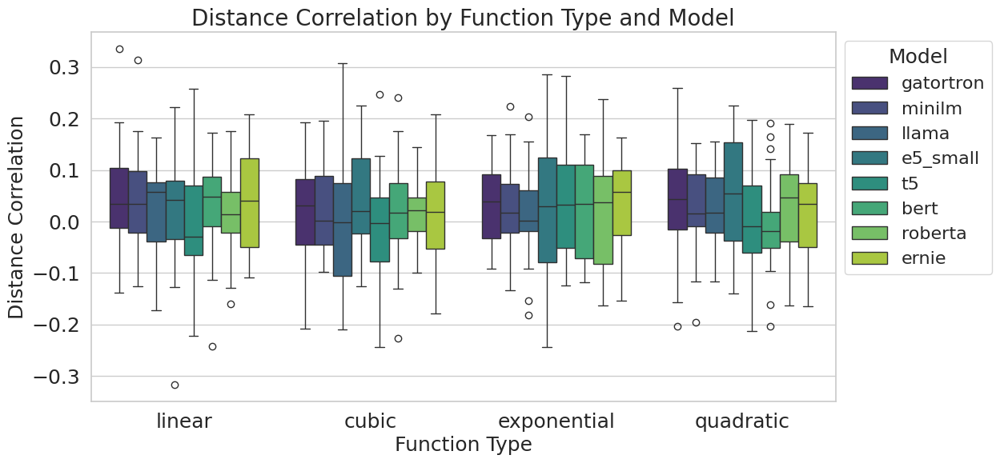

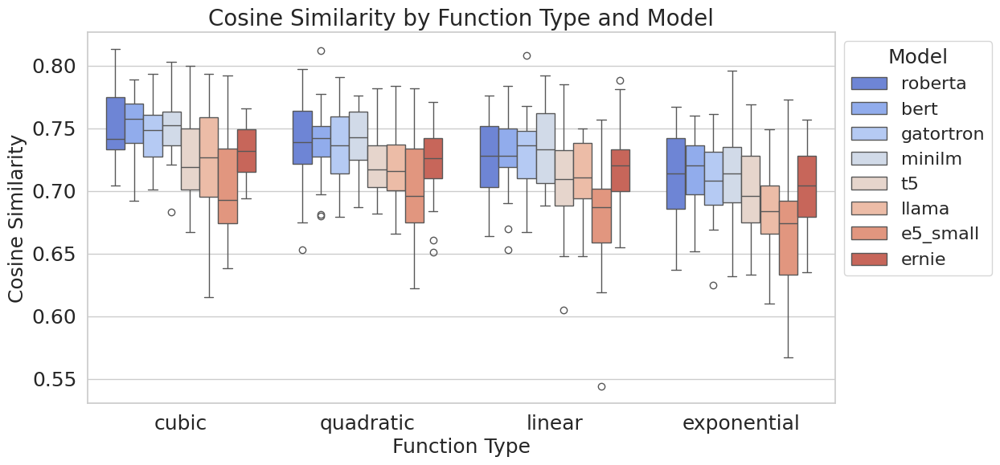

/tmp/ipykernel_1505124/712002315.py:75: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


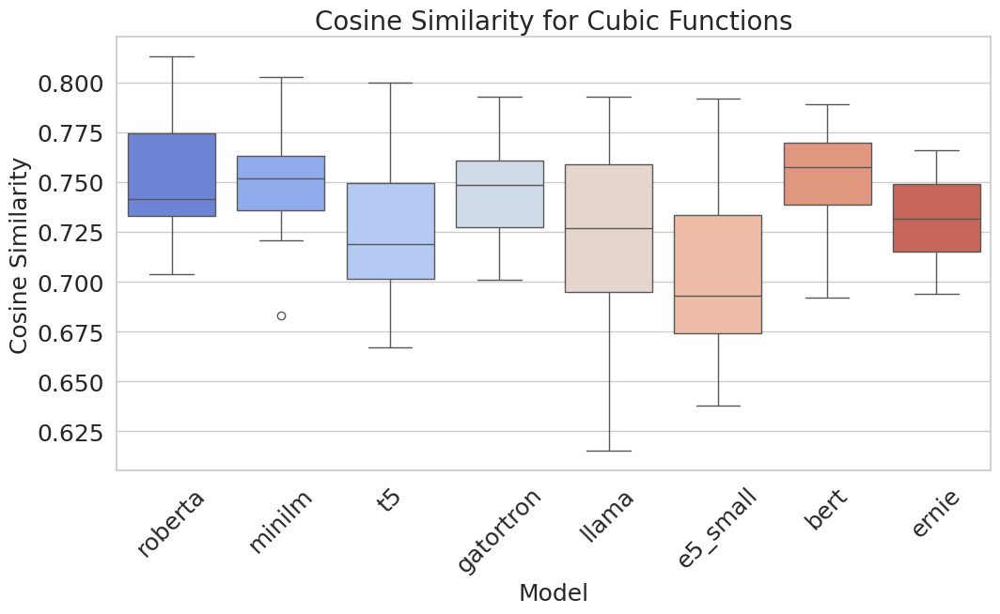

/tmp/ipykernel_1505124/712002315.py:75: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


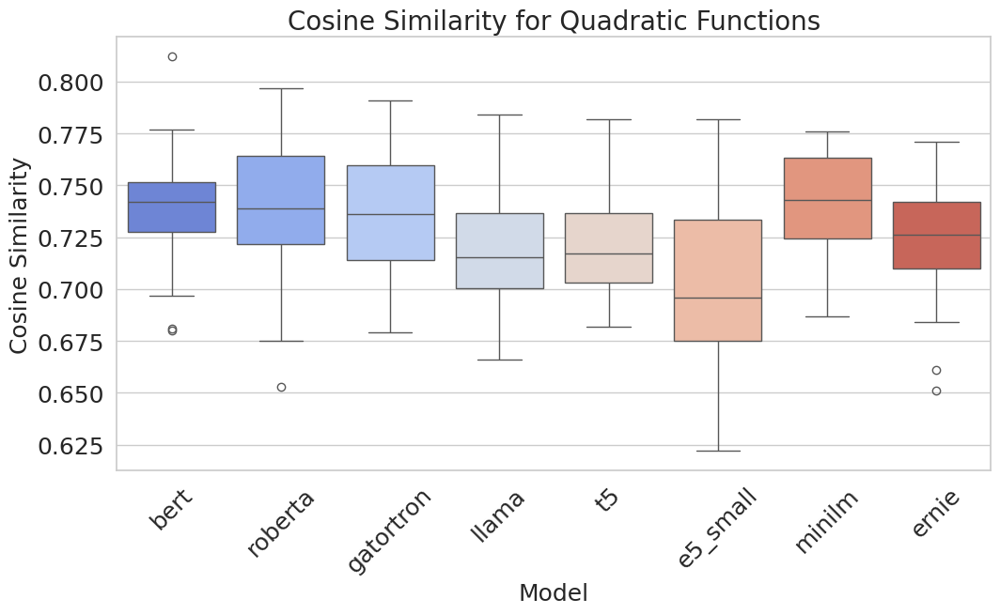

/tmp/ipykernel_1505124/712002315.py:75: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


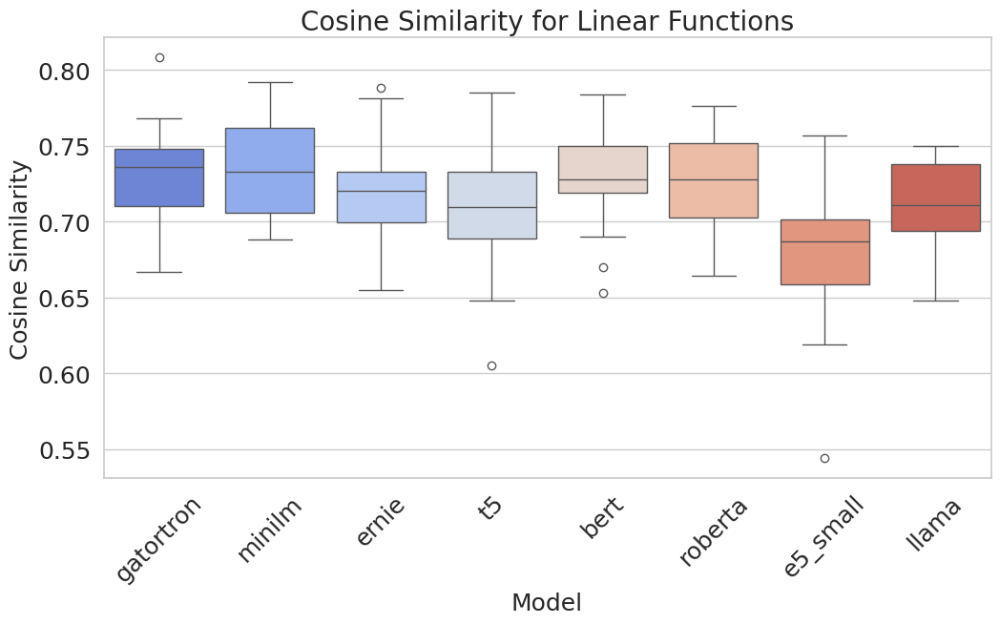

/tmp/ipykernel_1505124/712002315.py:75: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


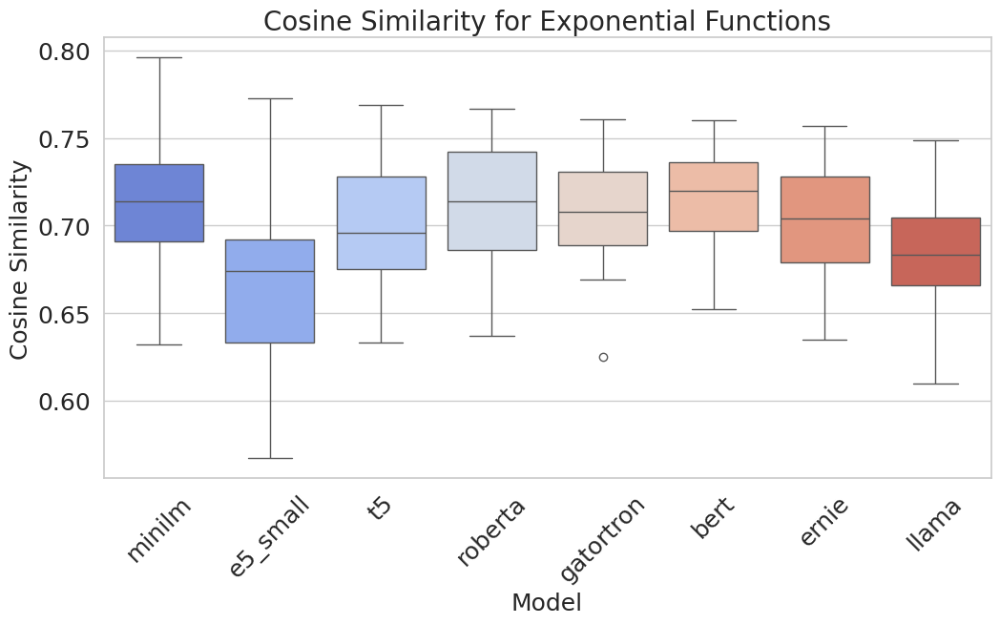

In [40]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# ✅ Load the results file if it exists
RESULTS_FILE = "cluster_similarity_results.csv"

if not os.path.exists(RESULTS_FILE):
    raise FileNotFoundError(f"❌ ERROR: The results file '{RESULTS_FILE}' was not found!")

results_df = pd.read_csv(RESULTS_FILE)

# ✅ Ensure that the dataset column is properly formatted
if "Dataset" in results_df.columns:
    results_df["Function Type"] = results_df["Dataset"].str.extract(r'_(linear|exponential|quadratic|cubic)')
else:
    raise ValueError("❌ ERROR: 'Dataset' column missing from results_df!")

# ✅ Sorting function
def sort_results(df, metric):
    """Sorts results within each function type based on the given metric in descending order."""
    if metric not in df.columns:
        raise ValueError(f"❌ ERROR: {metric} column is missing in results_df!")
    return df.sort_values(by=[metric], ascending=False)

# ✅ Ensure sorting for both metrics
sorted_distance_df = sort_results(results_df, "Distance Correlation")
sorted_cosine_df = sort_results(results_df, "Cosine Similarity")

# ✅ Set visualization style
sns.set(style="whitegrid")

# 📊 **Boxplot for Distance Correlation**
plt.figure(figsize=(12, 6))
sns.boxplot(
    x="Function Type", 
    y="Distance Correlation", 
    hue="Model", 
    data=sorted_distance_df, 
    palette="viridis", 
    dodge=True
)
plt.xlabel("Function Type", fontsize=18)
plt.ylabel("Distance Correlation", fontsize=18)
plt.title("Distance Correlation by Function Type and Model", fontsize=20)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.legend(title="Model", fontsize=16, title_fontsize=18, loc="upper left", bbox_to_anchor=(1, 1))
plt.show()

# 📊 **Boxplot for Cosine Similarity**
plt.figure(figsize=(12, 6))
sns.boxplot(
    x="Function Type", 
    y="Cosine Similarity", 
    hue="Model", 
    data=sorted_cosine_df, 
    palette="coolwarm", 
    dodge=True
)
plt.xlabel("Function Type", fontsize=18)
plt.ylabel("Cosine Similarity", fontsize=18)
plt.title("Cosine Similarity by Function Type and Model", fontsize=20)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.legend(title="Model", fontsize=16, title_fontsize=18, loc="upper left", bbox_to_anchor=(1, 1))
plt.show()

# 📊 **Separate Boxplots for Cosine Similarity by Function Type**
function_types = sorted_cosine_df["Function Type"].unique()
for ftype in function_types:
    plt.figure(figsize=(12, 6))
    subset = sorted_cosine_df[sorted_cosine_df["Function Type"] == ftype]
    sns.boxplot(
        x="Model", 
        y="Cosine Similarity", 
        data=subset, 
        palette="coolwarm"
    )
    plt.xlabel("Model", fontsize=18)
    plt.ylabel("Cosine Similarity", fontsize=18)
    plt.title(f"Cosine Similarity for {ftype.capitalize()} Functions", fontsize=20)
    plt.xticks(fontsize=18, rotation=45)
    plt.yticks(fontsize=18)
    plt.show()


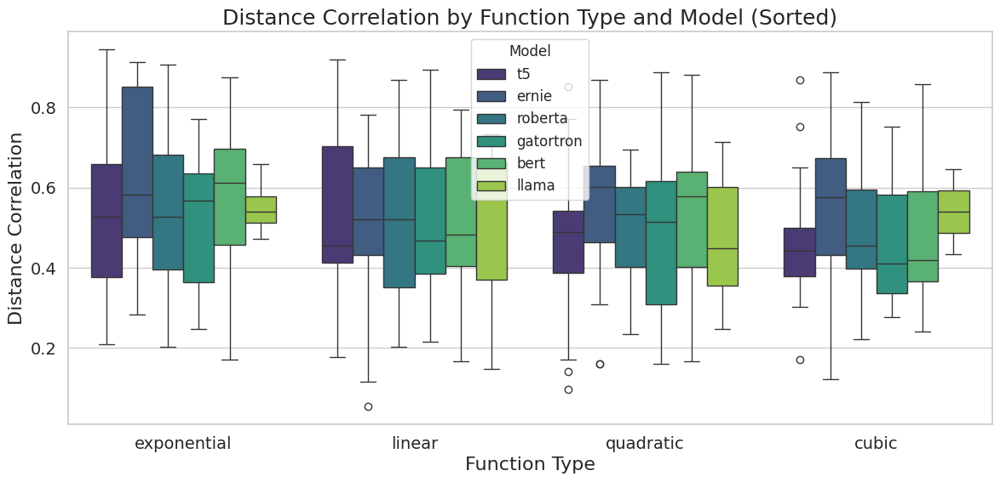

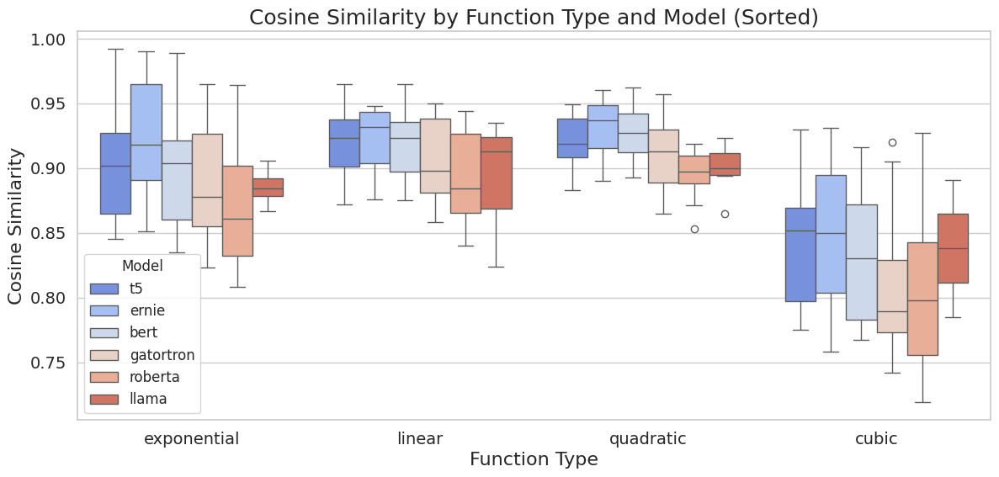

✅ Loaded 79 original datasets from /home/abbasali/synthetic data/generated_data_llama.
⚠️ Reducing embeddings for data_15_quadratic from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_6_linear from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_42_linear from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_71_cubic from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_91_linear from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_25_exponential from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_38_exponential from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_34_cubic from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_17_exponential from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_70_linear from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_27_exponential from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_35_cubic from 32000 to 3 dimensions.
⚠️ Reducing embeddings for data_33_quadratic from 3200

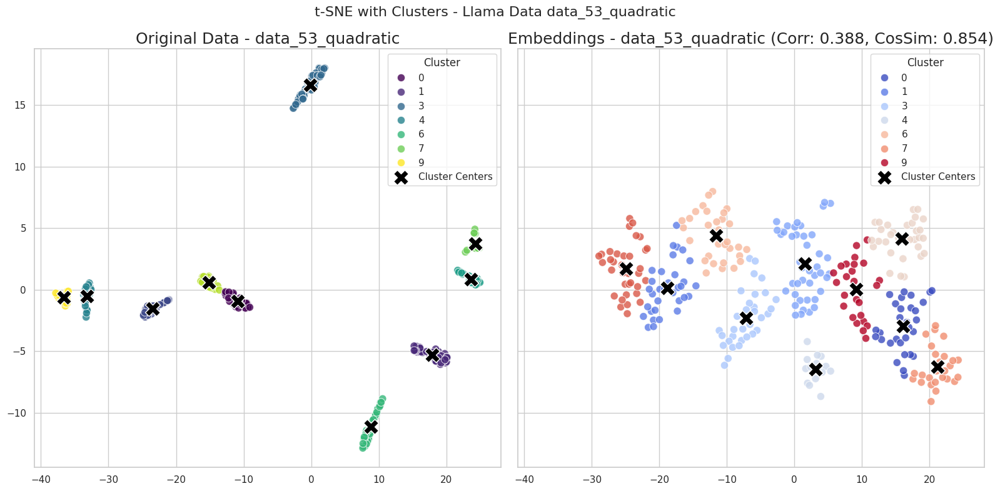

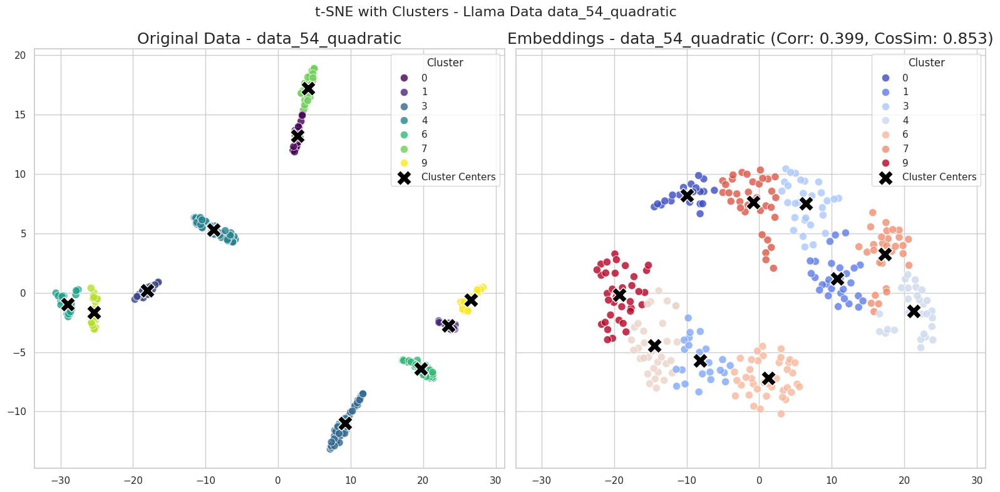

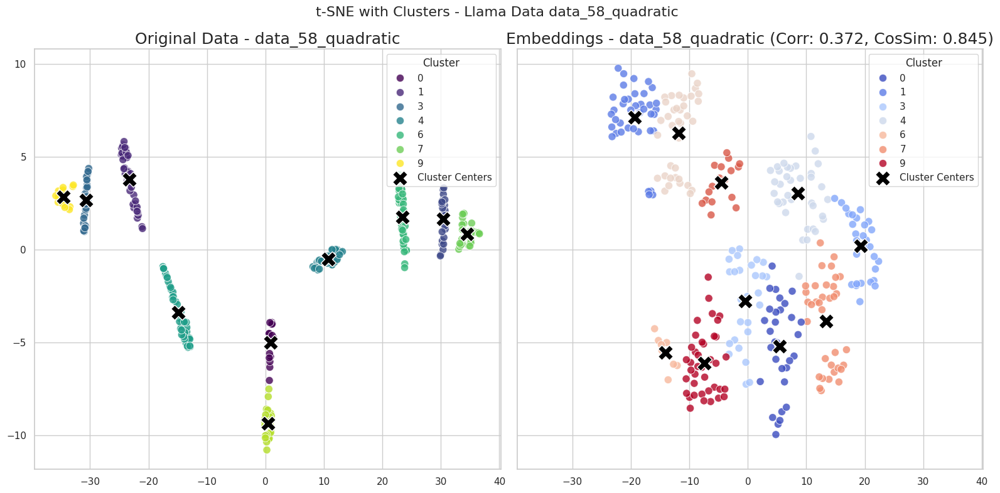

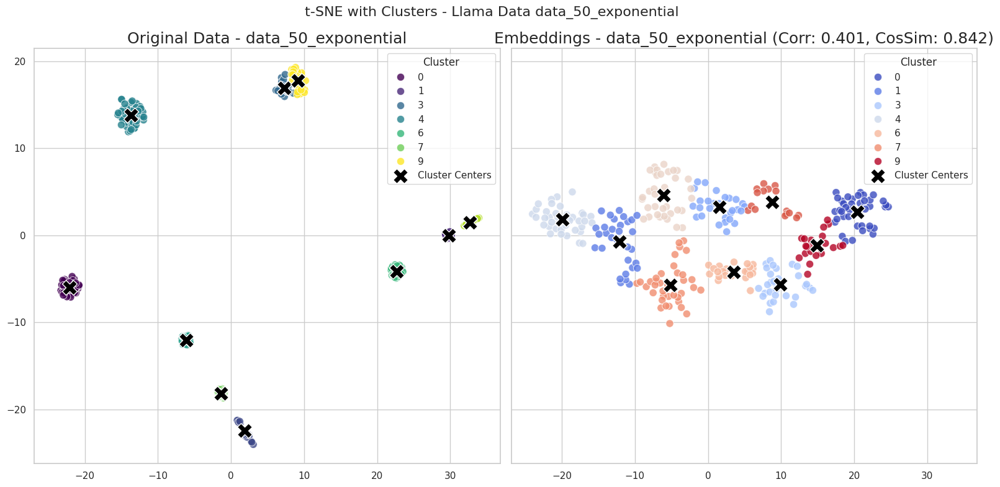

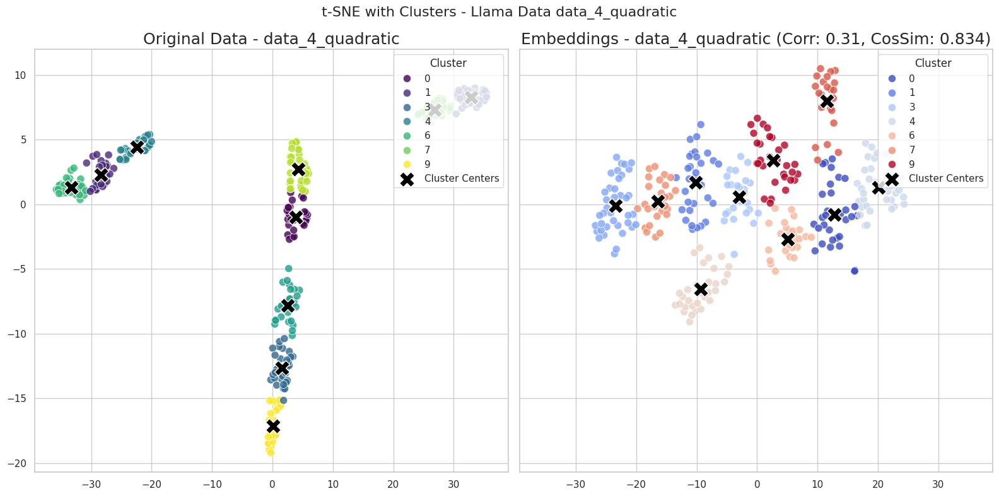

...

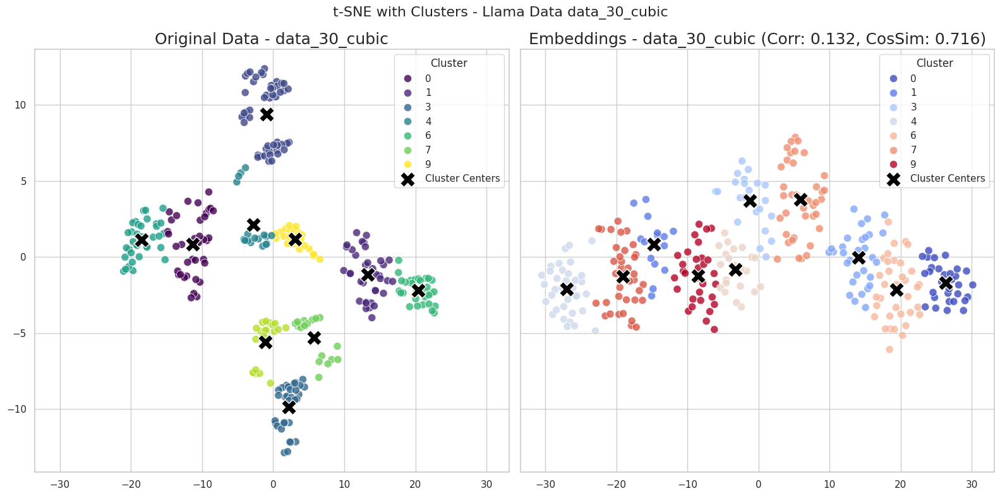

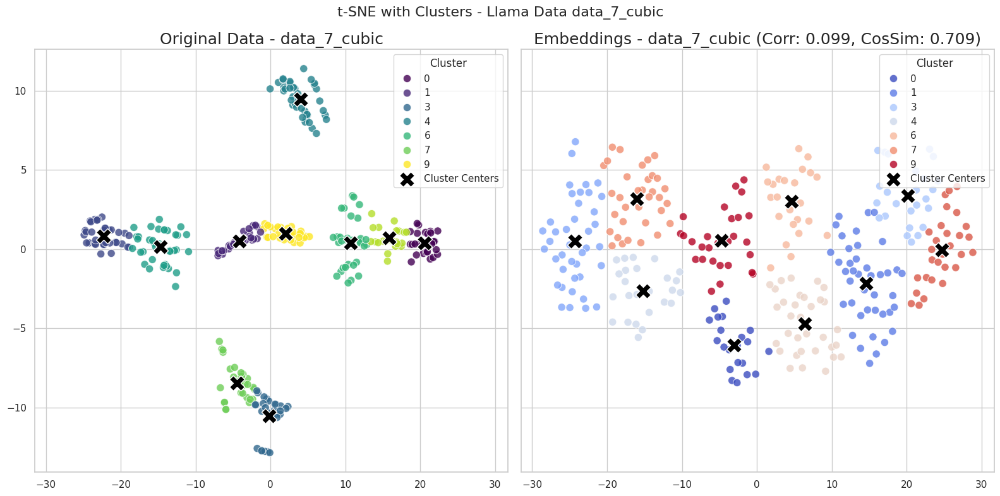

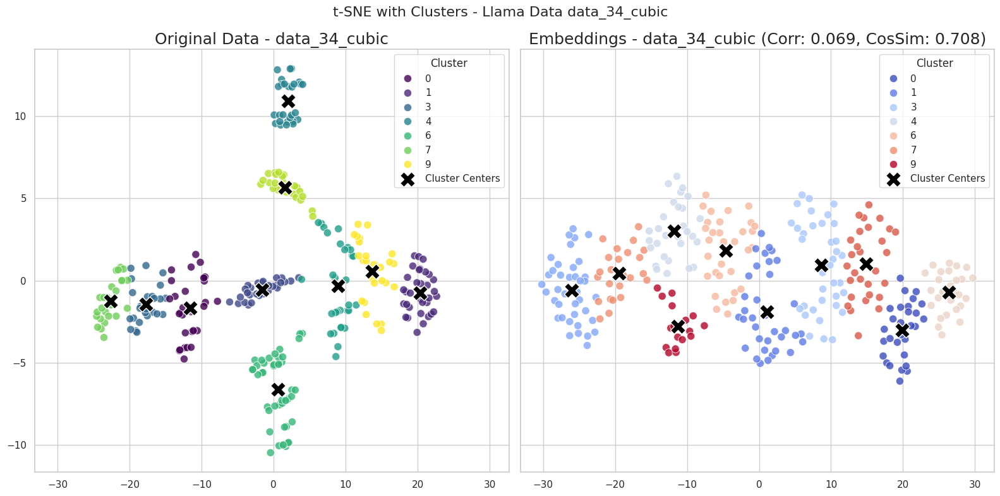

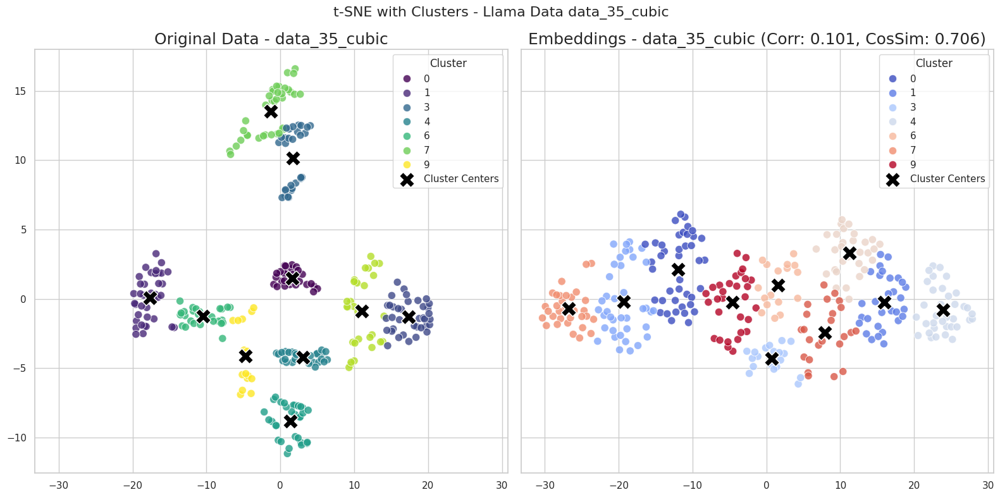

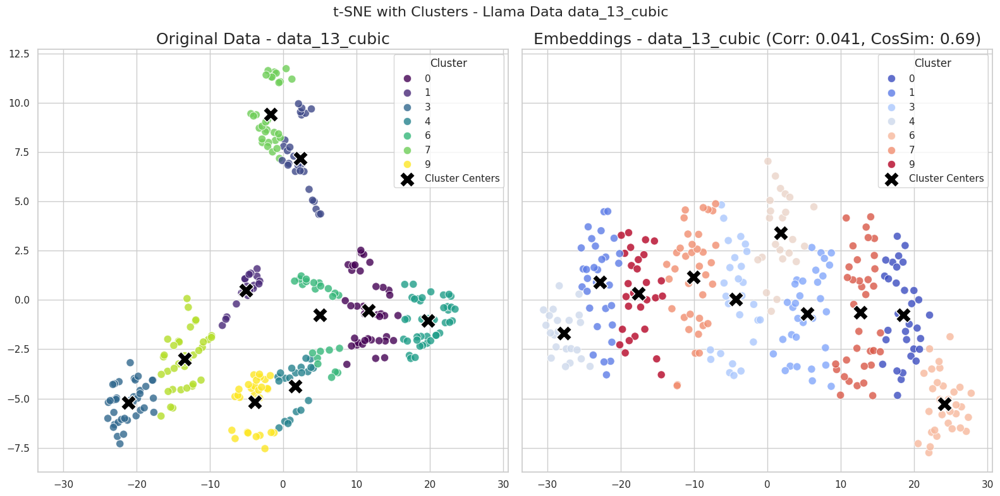

In [41]:
import pandas as pd
pd.set_option("display.max_columns", None)  # Show all columns
pd.set_option("display.max_rows", None)     # Show all rows
pd.set_option("display.width", 1000)        # Increase width
pd.set_option("display.colheader_justify", "center")  # Center align headers
pd.set_option("display.float_format", "{:.4f}".format)  # Limit decimal places

import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import h5py
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from scipy.spatial.distance import pdist, squareform
from scipy.stats import spearmanr
from sklearn.metrics.pairwise import cosine_similarity

# ✅ Define dataset-embedding directories (Llama only)
input_dir = "/home/abbasali/synthetic data/generated_data_llama"
output_dir = "/home/abbasali/synthetic data/embeddings_llama"

# ✅ Step 1: Load original datasets (Generated Data Llama)
dataframes = {}
csv_files = [f for f in os.listdir(input_dir) if f.endswith(".csv")]

for file in csv_files:
    dataset_name = os.path.splitext(file)[0]
    df = pd.read_csv(os.path.join(input_dir, file))
    
    # ✅ Drop non-numeric columns and ensure float32 type
    df_numeric = df.select_dtypes(include=[np.number])
    dataframes[dataset_name] = df_numeric.to_numpy(dtype=np.float32)  

print(f"✅ Loaded {len(dataframes)} original datasets from {input_dir}.")

# ✅ Step 2: Load embeddings (Only Llama)
embedding_files = [f for f in os.listdir(output_dir) if f.endswith(".h5")]
embeddings_data = {}

for file in embedding_files:
    dataset_name = file.replace("embeddings_", "").replace(".h5", "")

    if dataset_name in dataframes:
        with h5py.File(os.path.join(output_dir, file), 'r') as h5f:
            embeddings = np.array(h5f['embeddings'][:], dtype=np.float32)
            
            # ✅ Reduce embeddings with PCA to match original feature size
            original_dim = dataframes[dataset_name].shape[1]
            if embeddings.shape[1] > original_dim:
                print(f"⚠️ Reducing embeddings for {dataset_name} from {embeddings.shape[1]} to {original_dim} dimensions.")
                pca = PCA(n_components=original_dim)
                embeddings = pca.fit_transform(embeddings)
            
            embeddings_data[dataset_name] = embeddings

print(f"✅ Loaded {len(embeddings_data)} Llama embedding sets from {output_dir}.")

# ✅ Step 3: Compute Distance Correlation & Cosine Similarity
def compute_similarity(original_data, embedding_data):
    """Computes Distance Correlation and Cosine Similarity between original and embedding data."""
    
    # ✅ Use the first 300 samples for consistency
    sample_size = min(300, original_data.shape[0], embedding_data.shape[0])
    original_sample = original_data[:sample_size]
    embedding_sample = embedding_data[:sample_size]
    
    # ✅ Compute pairwise distances
    dist_orig = squareform(pdist(original_sample, metric='euclidean'))
    dist_emb = squareform(pdist(embedding_sample, metric='euclidean'))

    # ✅ Ensure both matrices have the same shape
    min_size = min(dist_orig.shape[0], dist_emb.shape[0])
    dist_orig, dist_emb = dist_orig[:min_size, :min_size], dist_emb[:min_size, :min_size]
    
    # ✅ Compute metrics
    correlation, _ = spearmanr(dist_orig.flatten(), dist_emb.flatten())
    cosine_sim = cosine_similarity(dist_orig.flatten().reshape(1, -1), dist_emb.flatten().reshape(1, -1))[0][0]

    return round(correlation, 3), round(cosine_sim, 3)

# ✅ Step 4: Compute Similarity for All Datasets & Sort by Cosine Similarity
similarity_results = []
for dataset_name, original_data in dataframes.items():
    if dataset_name not in embeddings_data:
        continue  # Skip if no embedding available

    embedding_data = embeddings_data[dataset_name]
    distance_corr, cosine_sim = compute_similarity(original_data, embedding_data)

    similarity_results.append((dataset_name, distance_corr, cosine_sim))

# ✅ Sort datasets by Cosine Similarity in descending order
sorted_datasets = sorted(similarity_results, key=lambda x: x[2], reverse=True)  # Sort by cosine similarity

# ✅ Step 5: Reduce dimensions and generate **Side-by-Side t-SNE plots with Clusters**
def plot_tsne_side_by_side(sorted_datasets, original_data_dict, embedding_data_dict, title_prefix):
    """Reduces dimensions using PCA & t-SNE, then plots **side-by-side** t-SNE visualizations with KMeans Clusters."""
    for dataset_name, distance_corr, cosine_sim in sorted_datasets:
        original_data = original_data_dict[dataset_name]
        embedding_data = embedding_data_dict[dataset_name]

        # ✅ Use only the first 300 samples
        sample_size = min(300, original_data.shape[0], embedding_data.shape[0])
        original_sample = original_data[:sample_size]
        embedding_sample = embedding_data[:sample_size]

        # ✅ Apply PCA (reduce to 50 dimensions, if applicable)
        pca_components = min(original_sample.shape[1], 50)
        pca = PCA(n_components=pca_components)
        pca_original = pca.fit_transform(original_sample)
        pca_embedding = pca.transform(embedding_sample)

        # ✅ Apply t-SNE (reduce to 2 dimensions)
        tsne = TSNE(n_components=2, perplexity=30, random_state=42)
        tsne_original = tsne.fit_transform(pca_original)
        tsne_embedding = tsne.fit_transform(pca_embedding)

        # ✅ Perform KMeans Clustering on t-SNE data
        optimal_clusters = min(10, sample_size // 10)  # Set a max of 10 clusters
        kmeans_original = KMeans(n_clusters=optimal_clusters, random_state=42, n_init=10).fit(tsne_original)
        kmeans_embedding = KMeans(n_clusters=optimal_clusters, random_state=42, n_init=10).fit(tsne_embedding)

        # ✅ Create side-by-side scatter plots
        fig, axes = plt.subplots(1, 2, figsize=(16, 8), sharex=True, sharey=True)

        # ✅ Left Plot: Original Data
        sns.scatterplot(ax=axes[0], x=tsne_original[:, 0], y=tsne_original[:, 1], hue=kmeans_original.labels_, palette="viridis", s=80, alpha=0.8)
        axes[0].scatter(kmeans_original.cluster_centers_[:, 0], kmeans_original.cluster_centers_[:, 1], s=300, c='black', marker='X', label="Cluster Centers", edgecolors='white')
        axes[0].set_title(f"Original Data - {dataset_name}", fontsize=18)
        axes[0].legend(title="Cluster", loc="upper right")
        axes[0].grid(True)

        # ✅ Right Plot: Embedding Data
        sns.scatterplot(ax=axes[1], x=tsne_embedding[:, 0], y=tsne_embedding[:, 1], hue=kmeans_embedding.labels_, palette="coolwarm", s=80, alpha=0.8)
        axes[1].scatter(kmeans_embedding.cluster_centers_[:, 0], kmeans_embedding.cluster_centers_[:, 1], s=300, c='black', marker='X', label="Cluster Centers", edgecolors='white')
        axes[1].set_title(f"Embeddings - {dataset_name} (Corr: {distance_corr}, CosSim: {cosine_sim})", fontsize=18)
        axes[1].legend(title="Cluster", loc="upper right")
        axes[1].grid(True)

        # ✅ Final Formatting
        plt.suptitle(f"{title_prefix} {dataset_name}", fontsize=16)
        plt.tight_layout()
        plt.show()

# ✅ Generate side-by-side t-SNE plots with clusters in order of highest cosine similarity first
plot_tsne_side_by_side(sorted_datasets, dataframes, embeddings_data, "t-SNE with Clusters - Llama Data")

import matplotlib.pyplot as plt
import seaborn as sns

def plot_tsne_one_by_one(sorted_datasets, dataframes, embeddings_data, title_prefix):
    """Generates separate t-SNE scatter plots for each dataset with clusters, one by one."""
    
    for dataset_name in sorted_datasets:
        if dataset_name not in dataframes or dataset_name not in embeddings_data:
            continue  # Skip if dataset is missing

        df = dataframes[dataset_name]
        embeddings = embeddings_data[dataset_name]

        # Extract t-SNE transformed data
        tsne_original = df["tsne_original"]
        tsne_embedding = embeddings["tsne_embedding"]

        # KMeans Clusters
        kmeans_original = df["kmeans_original"]
        kmeans_embedding = embeddings["kmeans_embedding"]

        # Correlation Metrics
        distance_corr = df["distance_correlation"]
        cosine_sim = df["cosine_similarity"]

        # ✅ Plot Original Data
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x=tsne_original[:, 0], y=tsne_original[:, 1], hue=kmeans_original.labels_, 
                        palette="viridis", s=80, alpha=0.8)
        plt.scatter(kmeans_original.cluster_centers_[:, 0], kmeans_original.cluster_centers_[:, 1], 
                    s=300, c='black', marker='X', label="Cluster Centers", edgecolors='white')
        plt.title(f"Original Data - {dataset_name}", fontsize=18)
        plt.legend(title="Cluster", loc="upper right")
        plt.grid(True)
        plt.show()

        # ✅ Plot Embedding Data
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x=tsne_embedding[:, 0], y=tsne_embedding[:, 1], hue=kmeans_embedding.labels_, 
                        palette="coolwarm", s=80, alpha=0.8)
        plt.scatter(kmeans_embedding.cluster_centers_[:, 0], kmeans_embedding.cluster_centers_[:, 1], 
                    s=300, c='black', marker='X', label="Cluster Centers", edgecolors='white')
        plt.title(f"Embeddings - {dataset_name} (Corr: {distance_corr}, CosSim: {cosine_sim})", fontsize=18)
        plt.legend(title="Cluster", loc="upper right")
        plt.grid(True)
        plt.show()

# ✅ Generate separate t-SNE plots for each dataset
plot_tsne_one_by_one(sorted_datasets, dataframes, embeddings_data, "t-SNE with Clusters - Llama Data")


✅ Loaded 100 original datasets from /home/abbasali/synthetic data/generated_data.
✅ Loaded 500 embedding sets from /home/abbasali/synthetic data/embeddings.


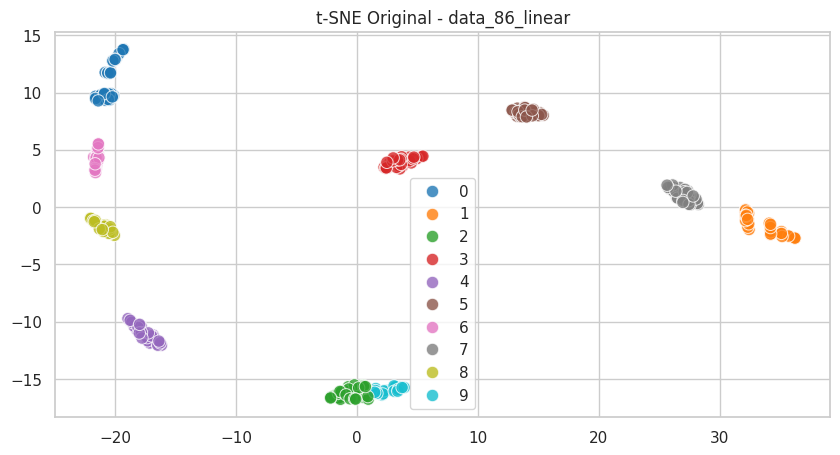

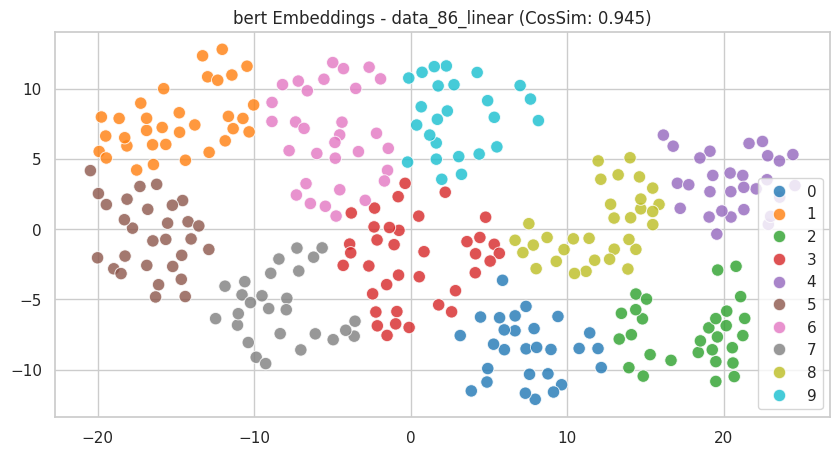

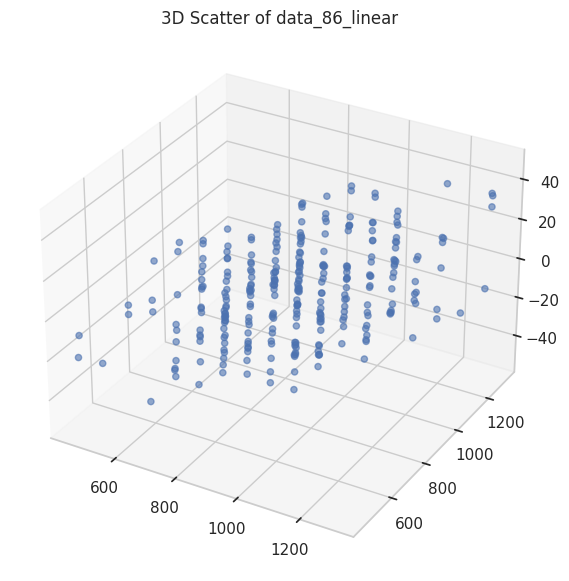

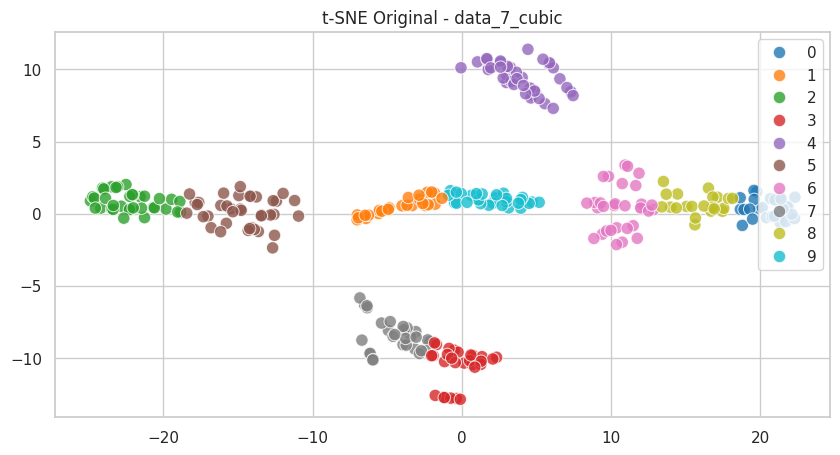

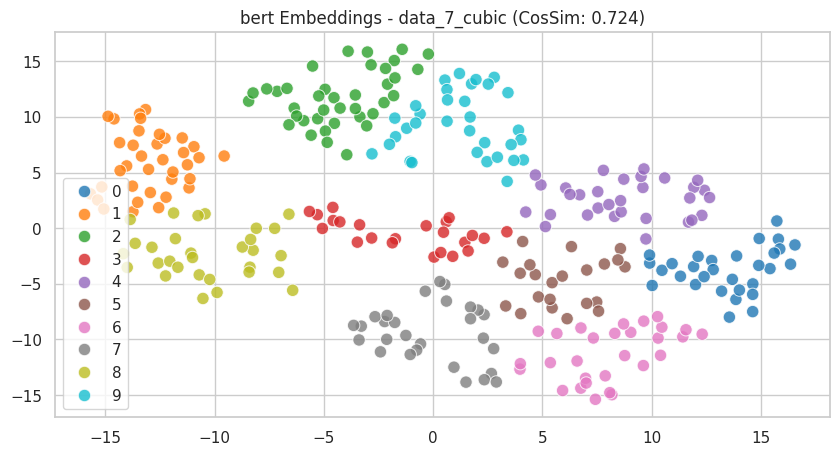

...

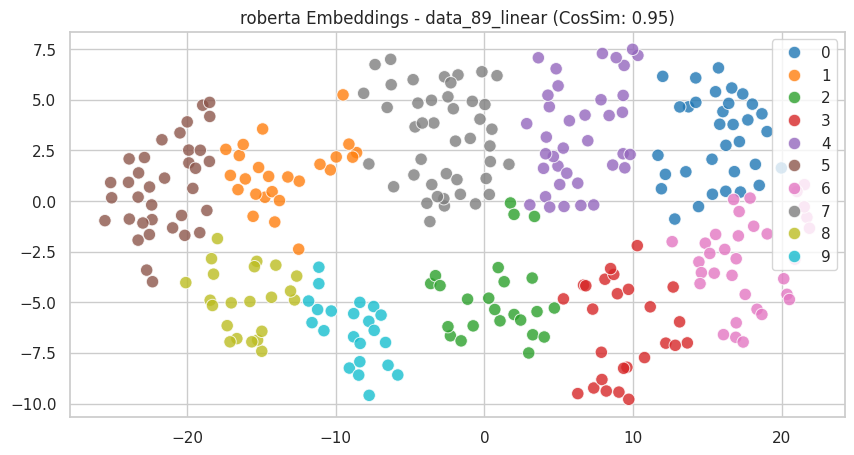

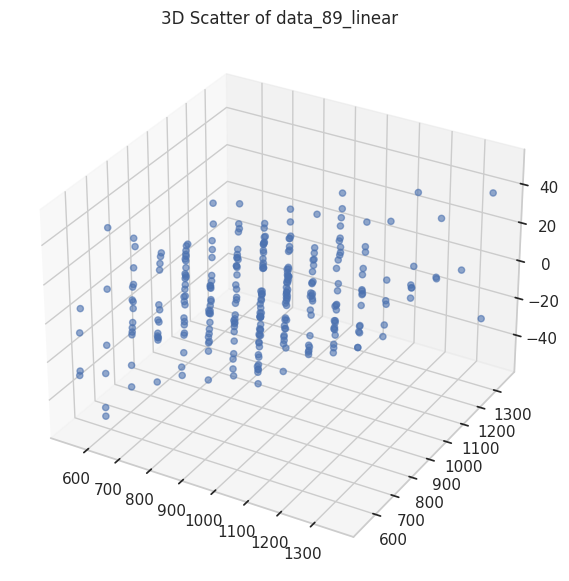

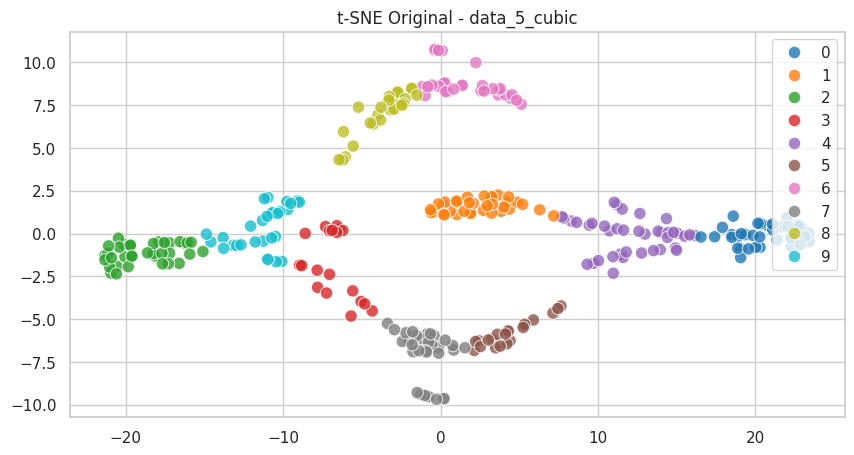

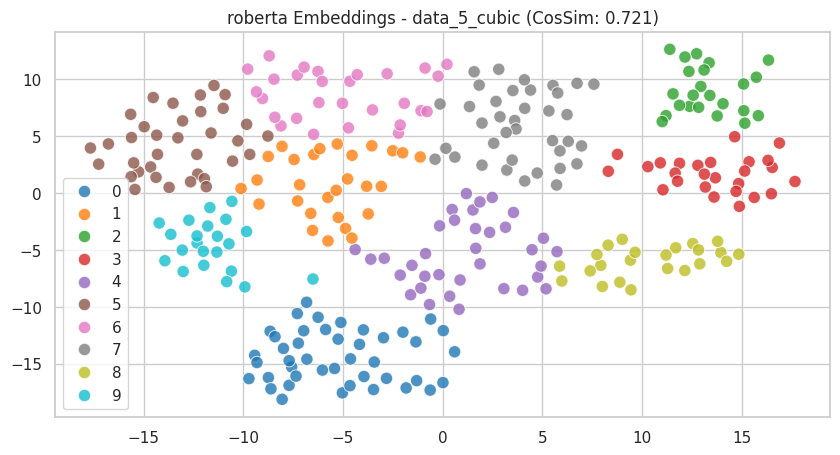

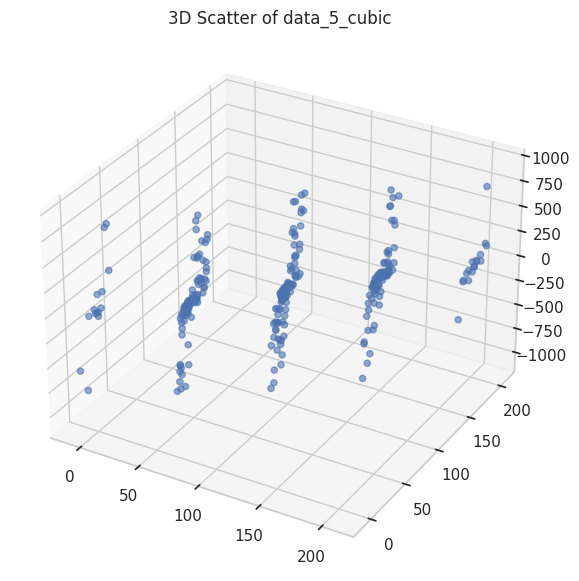

In [78]:
import pandas as pd
pd.set_option("display.max_columns", None)  # Show all columns
pd.set_option("display.max_rows", None)     # Show all rows
pd.set_option("display.width", 1000)        # Increase width
pd.set_option("display.colheader_justify", "center")  # Center align headers
pd.set_option("display.float_format", "{:.4f}".format)  # Limit decimal places

import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import h5py
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from scipy.spatial.distance import pdist, squareform
from scipy.stats import spearmanr
from sklearn.metrics.pairwise import cosine_similarity

# ✅ Define dataset-embedding directories
input_dir = "/home/abbasali/synthetic data/generated_data"
output_dir = "/home/abbasali/synthetic data/embeddings"

# ✅ Load original datasets
dataframes = {}
csv_files = [f for f in os.listdir(input_dir) if f.endswith(".csv")]

for file in csv_files:
    dataset_name = os.path.splitext(file)[0]
    df = pd.read_csv(os.path.join(input_dir, file))
    
    df_numeric = df.select_dtypes(include=[np.number])  # Drop non-numeric columns
    dataframes[dataset_name] = df_numeric.to_numpy(dtype=np.float32)

print(f"✅ Loaded {len(dataframes)} original datasets from {input_dir}.")

# ✅ Load embeddings (Ernie, Bert, Gatortron, Roberta, T5)
embedding_files = [f for f in os.listdir(output_dir) if f.endswith(".npy")]
embeddings_data = {}

for file in embedding_files:
    parts = file.replace("embeddings_", "").replace(".npy", "").split("_")
    model_name = parts[0]  # Extract model name
    dataset_name = "_".join(parts[1:])  # Extract dataset name

    if dataset_name in dataframes:
        embeddings = np.load(os.path.join(output_dir, file)).astype(np.float32)
        embeddings = np.atleast_2d(embeddings)  # Ensure 2D format

        if embeddings.size == 0 or embeddings.shape[0] < 2:
            continue  # Skip empty embeddings

        # ✅ Reduce embeddings with PCA to match original feature size
        original_dim = dataframes[dataset_name].shape[1]
        if embeddings.shape[1] > original_dim:
            pca = PCA(n_components=original_dim)
            embeddings = pca.fit_transform(embeddings)

        if dataset_name not in embeddings_data:
            embeddings_data[dataset_name] = {}
        embeddings_data[dataset_name][model_name] = embeddings

print(f"✅ Loaded {sum(len(v) for v in embeddings_data.values())} embedding sets from {output_dir}.")

# ✅ Compute Distance Correlation & Cosine Similarity
def compute_similarity(original_data, embedding_data):
    """Computes Distance Correlation and Cosine Similarity."""
    
    original_data = np.atleast_2d(original_data)
    embedding_data = np.atleast_2d(embedding_data)

    if original_data.size == 0 or embedding_data.size == 0:
        return np.nan, np.nan

    sample_size = min(300, original_data.shape[0], embedding_data.shape[0])
    original_sample = original_data[:sample_size]
    embedding_sample = embedding_data[:sample_size]

    if original_sample.shape[1] != embedding_sample.shape[1]:
        return np.nan, np.nan

    dist_orig = squareform(pdist(original_sample, metric='euclidean'))
    dist_emb = squareform(pdist(embedding_sample, metric='euclidean'))

    min_size = min(dist_orig.shape[0], dist_emb.shape[0])
    dist_orig, dist_emb = dist_orig[:min_size, :min_size], dist_emb[:min_size, :min_size]

    correlation, _ = spearmanr(dist_orig.flatten(), dist_emb.flatten())
    cosine_sim = cosine_similarity(dist_orig.flatten().reshape(1, -1), dist_emb.flatten().reshape(1, -1))[0][0]

    return round(correlation, 3), round(cosine_sim, 3)

# ✅ Compute Similarity for All Datasets & Sort by Cosine Similarity
similarity_results = []
for dataset_name, original_data in dataframes.items():
    if dataset_name not in embeddings_data:
        continue

    for model_name, embedding_data in embeddings_data[dataset_name].items():
        distance_corr, cosine_sim = compute_similarity(original_data, embedding_data)
        similarity_results.append((dataset_name, model_name, distance_corr, cosine_sim))

similarity_df = pd.DataFrame(similarity_results, columns=["Dataset", "Model", "Distance Correlation", "Cosine Similarity"])
similarity_df = similarity_df.dropna()  # Remove NaN values before sorting

# ✅ Find best and worst cosine similarity datasets per model
best_worst_per_model = {}
for model in similarity_df["Model"].unique():
    model_df = similarity_df[similarity_df["Model"] == model].dropna(subset=["Cosine Similarity"])
    if model_df.empty:
        continue

    best = model_df.loc[model_df["Cosine Similarity"].idxmax()]
    worst = model_df.loc[model_df["Cosine Similarity"].idxmin()]
    best_worst_per_model[model] = [best, worst]

# ✅ Visualization: 3D Scatter + t-SNE with KMeans Overlay
def plot_3d_tsne_side_by_side(best_worst_per_model, original_data_dict, embedding_data_dict):
    """Plots **3D scatter + side-by-side** t-SNE with **KMeans Clustering Overlay**."""
    for model_name, (best, worst) in best_worst_per_model.items():
        for dataset in [best, worst]:
            dataset_name, _, distance_corr, cosine_sim = dataset

            original_data = original_data_dict[dataset_name]
            embedding_data = embedding_data_dict[dataset_name][model_name]

            original_data = np.atleast_2d(original_data)
            embedding_data = np.atleast_2d(embedding_data)

            sample_size = min(300, original_data.shape[0], embedding_data.shape[0])
            original_sample = original_data[:sample_size]
            embedding_sample = embedding_data[:sample_size]

            # ✅ Apply PCA
            pca = PCA(n_components=50) if original_sample.shape[1] > 50 else PCA(n_components=original_sample.shape[1])
            pca_original = pca.fit_transform(original_sample)
            pca_embedding = pca.transform(embedding_sample)

            # ✅ Apply t-SNE
            tsne = TSNE(n_components=2, perplexity=30, random_state=42)
            tsne_original = tsne.fit_transform(pca_original)
            tsne_embedding = tsne.fit_transform(pca_embedding)

            # ✅ Perform KMeans Clustering on t-SNE data
            optimal_clusters = min(10, sample_size // 10)  # Max of 10 clusters
            kmeans_original = KMeans(n_clusters=optimal_clusters, random_state=42, n_init=10).fit(tsne_original)
            kmeans_embedding = KMeans(n_clusters=optimal_clusters, random_state=42, n_init=10).fit(tsne_embedding)

            # ✅ Left Plot: Original Data with Clusters
            plt.figure(figsize=(10, 5))
            sns.scatterplot(x=tsne_original[:, 0], y=tsne_original[:, 1], hue=kmeans_original.labels_, palette="tab10", s=80, alpha=0.8)
            plt.title(f"t-SNE Original - {dataset_name}")

            # ✅ Right Plot: Embedding Data with Clusters
            plt.figure(figsize=(10, 5))
            sns.scatterplot(x=tsne_embedding[:, 0], y=tsne_embedding[:, 1], hue=kmeans_embedding.labels_, palette="tab10", s=80, alpha=0.8)
            plt.title(f"{model_name} Embeddings - {dataset_name} (CosSim: {cosine_sim})")
            plt.show()

            # ✅ 3D Scatter Plot of Original Data
            fig = plt.figure(figsize=(10, 7))
            ax = fig.add_subplot(111, projection='3d')
            ax.scatter(original_sample[:, 0], original_sample[:, 1], original_sample[:, 2], alpha=0.6)
            ax.set_title(f"3D Scatter of {dataset_name}")
            plt.show()

plot_3d_tsne_side_by_side(best_worst_per_model, dataframes, embeddings_data)


/tmp/ipykernel_973/3504825753.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Function Type", y="Distance Correlation", data=results_df, palette="viridis")


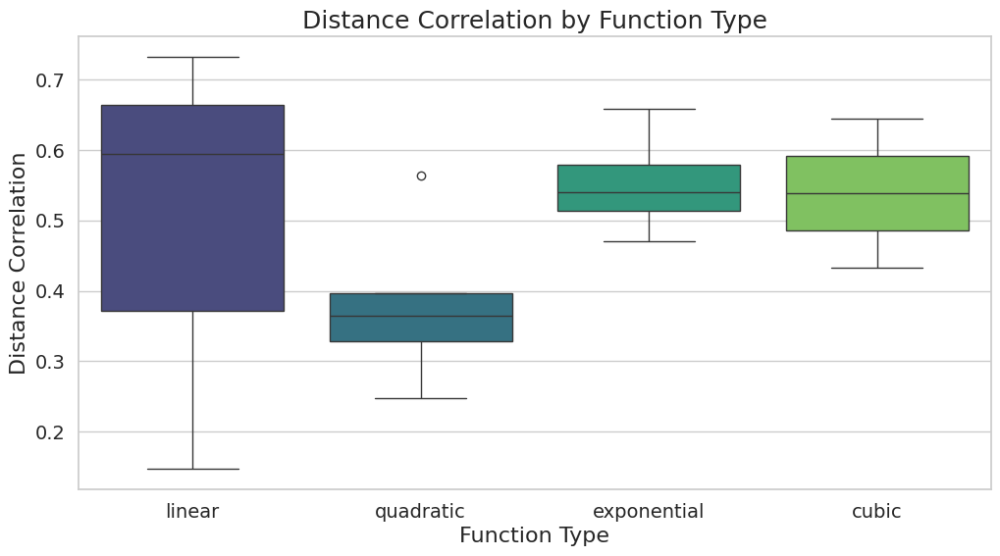

/tmp/ipykernel_973/3504825753.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Function Type", y="Cosine Similarity", data=results_df, palette="coolwarm")


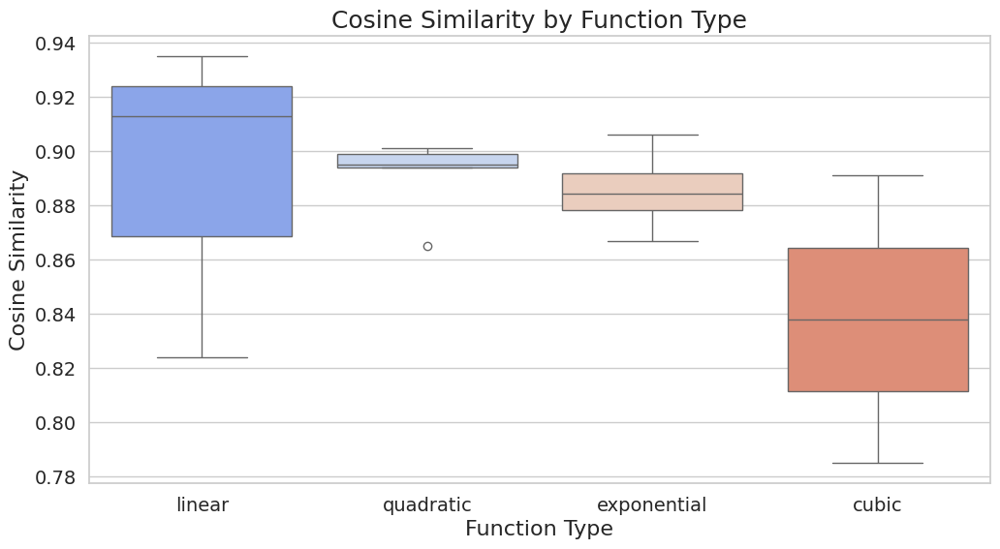

In [33]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample DataFrame (Replace this with your actual dataset)
# results_df = pd.read_csv("your_file.csv")

# Extract the function type from the Dataset column
results_df["Function Type"] = results_df["Dataset"].str.extract(r'_(linear|exponential|quadratic|cubic)')

# Set visualization style
sns.set(style="whitegrid")

# **Boxplot for Distance Correlation Grouped by Function Type**
plt.figure(figsize=(12, 6))
sns.boxplot(x="Function Type", y="Distance Correlation", data=results_df, palette="viridis")

plt.xlabel("Function Type", fontsize=16)
plt.ylabel("Distance Correlation", fontsize=16)
plt.title("Distance Correlation by Function Type", fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.show()

# **Boxplot for Cosine Similarity Grouped by Function Type**
plt.figure(figsize=(12, 6))
sns.boxplot(x="Function Type", y="Cosine Similarity", data=results_df, palette="coolwarm")

plt.xlabel("Function Type", fontsize=16)
plt.ylabel("Cosine Similarity", fontsize=16)
plt.title("Cosine Similarity by Function Type", fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.show()


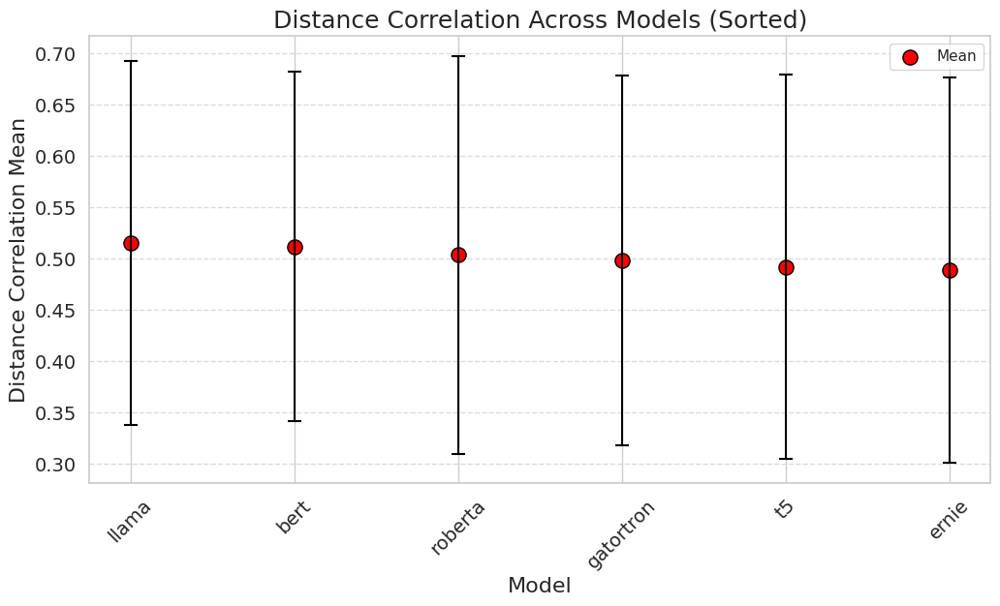

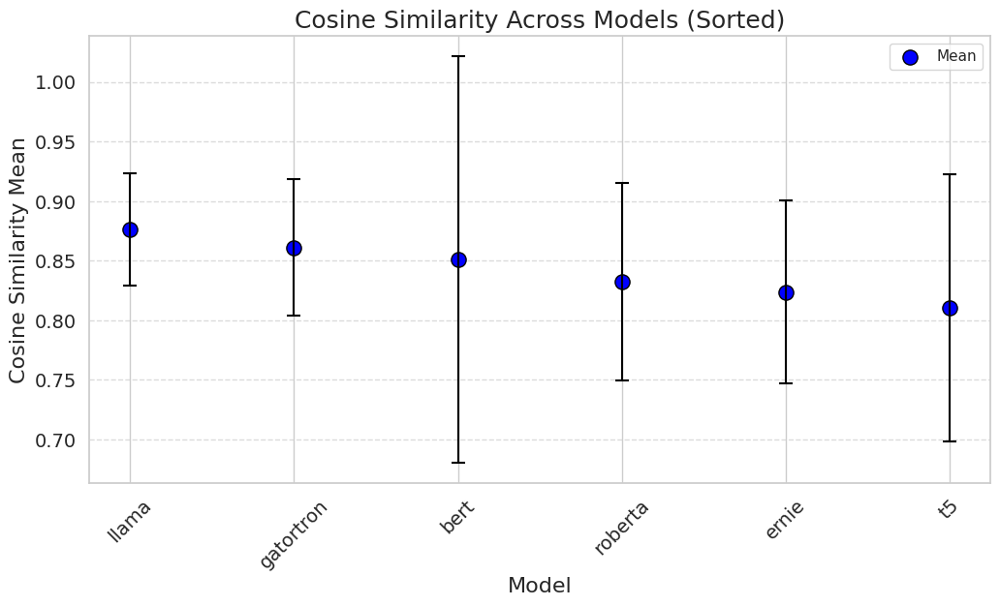

In [29]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load and clean CSV
summary_df = pd.read_csv('summary.csv', header=1)
summary_df.columns = ['Model', 'Distance Correlation Mean', 'Distance Correlation Std', 
                      'Cosine Similarity Mean', 'Cosine Similarity Std']

# Convert columns to numeric
numeric_cols = summary_df.columns[1:]
summary_df[numeric_cols] = summary_df[numeric_cols].apply(pd.to_numeric, errors='coerce')

# Set visualization style
sns.set(style="whitegrid")

# **Sort Data by Distance Correlation Mean in Descending Order**
sorted_distance_df = summary_df.sort_values(by="Distance Correlation Mean", ascending=False)

plt.figure(figsize=(12, 6))

# Scatter plot for means
plt.scatter(sorted_distance_df["Model"], sorted_distance_df["Distance Correlation Mean"], 
            color='red', s=120, edgecolors='black', label="Mean")

# Error bars
plt.errorbar(sorted_distance_df["Model"], sorted_distance_df["Distance Correlation Mean"], 
             yerr=sorted_distance_df["Distance Correlation Std"], fmt='none', 
             ecolor='black', capsize=5, capthick=1.5, elinewidth=1.5)

# Formatting
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Model", fontsize=16)
plt.ylabel("Distance Correlation Mean", fontsize=16)
plt.title("Distance Correlation Across Models (Sorted)", fontsize=18)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# **Sort Data by Cosine Similarity Mean in Descending Order**
sorted_cosine_df = summary_df.sort_values(by="Cosine Similarity Mean", ascending=False)

plt.figure(figsize=(12, 6))

# Scatter plot for means
plt.scatter(sorted_cosine_df["Model"], sorted_cosine_df["Cosine Similarity Mean"], 
            color='blue', s=120, edgecolors='black', label="Mean")

# Error bars
plt.errorbar(sorted_cosine_df["Model"], sorted_cosine_df["Cosine Similarity Mean"], 
             yerr=sorted_cosine_df["Cosine Similarity Std"], fmt='none', 
             ecolor='black', capsize=5, capthick=1.5, elinewidth=1.5)

# Formatting
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Model", fontsize=16)
plt.ylabel("Cosine Similarity Mean", fontsize=16)
plt.title("Cosine Similarity Across Models (Sorted)", fontsize=18)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


/tmp/ipykernel_973/3071221424.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Model", y="Distance Correlation Mean", data=summary_df, palette="viridis", ci=None)
/tmp/ipykernel_973/3071221424.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Model", y="Distance Correlation Mean", data=summary_df, palette="viridis", ci=None)


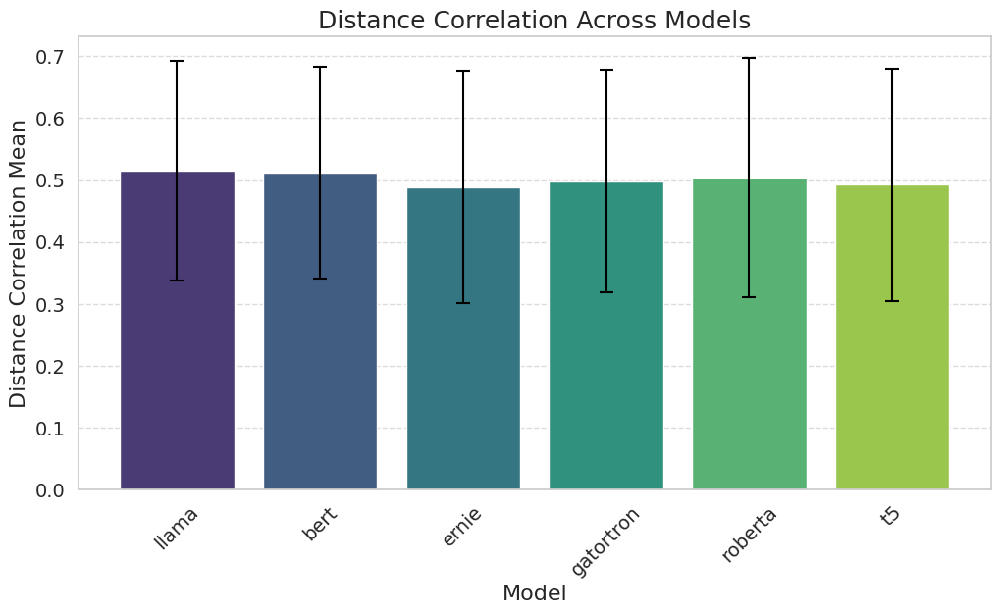

/tmp/ipykernel_973/3071221424.py:38: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x="Model", y="Cosine Similarity Mean", data=summary_df, palette="coolwarm", ci=None)
/tmp/ipykernel_973/3071221424.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Model", y="Cosine Similarity Mean", data=summary_df, palette="coolwarm", ci=None)


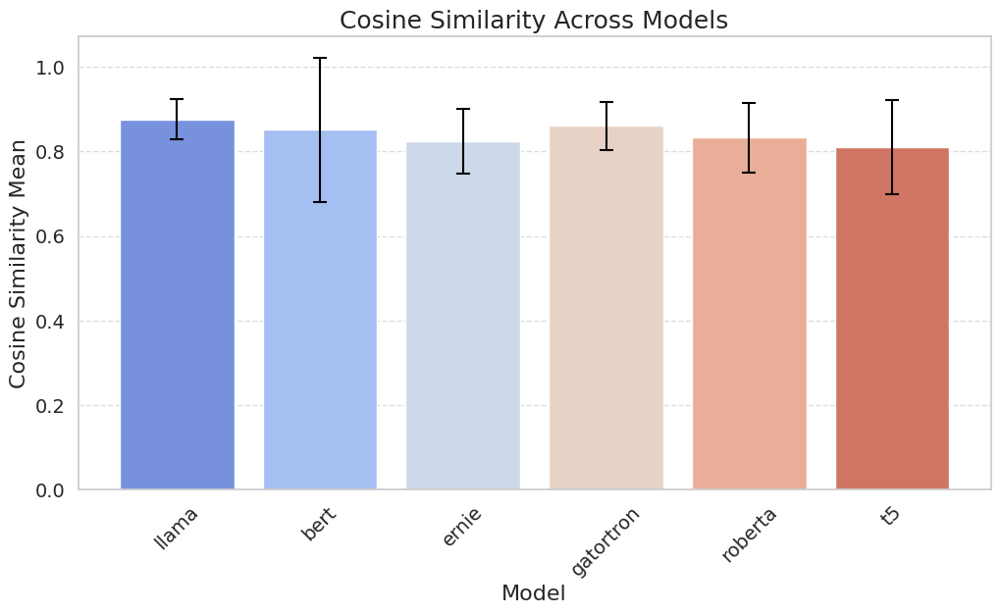

In [26]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load and clean CSV
summary_df = pd.read_csv('summary.csv', header=1)
summary_df.columns = ['Model', 'Distance Correlation Mean', 'Distance Correlation Std', 
                      'Cosine Similarity Mean', 'Cosine Similarity Std']

# Convert columns to numeric
numeric_cols = summary_df.columns[1:]
summary_df[numeric_cols] = summary_df[numeric_cols].apply(pd.to_numeric, errors='coerce')

# Set visualization style
sns.set(style="whitegrid")

# **Improved Plot: Bar plot with Matplotlib error bars for Distance Correlation**
plt.figure(figsize=(12, 6))
ax = sns.barplot(x="Model", y="Distance Correlation Mean", data=summary_df, palette="viridis", ci=None)

# Add error bars manually using Matplotlib
for i, bar in enumerate(ax.patches):
    x = bar.get_x() + bar.get_width() / 2
    y = bar.get_height()
    err = summary_df["Distance Correlation Std"].iloc[i]
    plt.errorbar(x, y, yerr=err, fmt='none', ecolor='black', capsize=5, capthick=1.5, elinewidth=1.5)

plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Model", fontsize=16)
plt.ylabel("Distance Correlation Mean", fontsize=16)
plt.title("Distance Correlation Across Models", fontsize=18)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# **Improved Plot: Bar plot with Matplotlib error bars for Cosine Similarity**
plt.figure(figsize=(12, 6))
ax = sns.barplot(x="Model", y="Cosine Similarity Mean", data=summary_df, palette="coolwarm", ci=None)

# Add error bars manually using Matplotlib
for i, bar in enumerate(ax.patches):
    x = bar.get_x() + bar.get_width() / 2
    y = bar.get_height()
    err = summary_df["Cosine Similarity Std"].iloc[i]
    plt.errorbar(x, y, yerr=err, fmt='none', ecolor='black', capsize=5, capthick=1.5, elinewidth=1.5)

plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Model", fontsize=16)
plt.ylabel("Cosine Similarity Mean", fontsize=16)
plt.title("Cosine Similarity Across Models", fontsize=18)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6 entries, 0 to 5
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  6 non-null      object 
 1   mean        6 non-null      float64
 2   std         6 non-null      float64
 3   mean.1      6 non-null      float64
 4   std.1       6 non-null      float64
dtypes: float64(4), object(1)
memory usage: 368.0+ bytes
  Unnamed: 0      mean       std    mean.1     std.1
0      llama  0.515667  0.177299  0.876111  0.047025
1       bert  0.511960  0.170502  0.851030  0.170502
2      ernie  0.489020  0.187727  0.823740  0.076882
3  gatortron  0.498280  0.180313  0.861190  0.056885
4    roberta  0.503750  0.193689  0.832420  0.082608


In [1]:
#to write file to html
import nbformat
from nbconvert import HTMLExporter

# Load your notebook
with open("synthetic_llama_plotting.ipynb") as f:
    nb = nbformat.read(f, as_version=4)

# Convert to HTML
exporter = HTMLExporter()
body, _ = exporter.from_notebook_node(nb)

# Write the HTML to a file
with open("synthetic_llama_plotting.ipynb.html", "w") as f:
    f.write(body)
